In [2]:
import numpy as np
import pandas as pd
# import scanpy.api as sc
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import matplotlib as mpl
mpl.rcParams['figure.facecolor'] = (1,1,1,1)
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis', 
                              transparent=False, frameon=False, fontsize=20)  # low dpi (dots per inch) yields small inline figures

import matplotlib as mpl
# 2 lines below solved the facecolor problem.
# mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['figure.facecolor'] = (1,1,1,1)
sc.settings.autosave = True
sc.logging.print_versions()

version = '210711_merged_thymoma_MG21.22.23.03_Tcell'

# file_mat = 'F1314_200323_222536_summary/10425963-2_3DE_genematrix.csv'


results_file_Tcell = './scanpy/{}/merge_Tcell.h5ad'.format(version)
results_file_CD4Tcell = './scanpy/{}/merge_CD4Tcell.h5ad'.format(version)
results_file_Treg = './scanpy/{}/merge_Treg.h5ad'.format(version)

results_file_cg_CD4Tcell = './scanpy/{}/merge_cg_CD4Tcell.h5ad'.format(version)
results_file_cg_Treg = './scanpy/{}/merge_cg_Treg.h5ad'.format(version)
# results_file_Tcell_minor_cluster = './scanpy/{}/merge_Tcell_minor_cluster.h5ad'.format(version)

results_file_master = './scanpy/210711_merged_thymoma_MG21.22.23.03/merge.h5ad'
results_raw_file_master = './scanpy/210711_merged_thymoma_MG21.22.23.03/merge.raw.h5ad'

# for cellphonedb
raw_matrix = './scanpy/{}/merge.raw.tsv'.format(version)

sc.settings.figdir = './scanpy/{}/graph'.format(version)
sc.settings.cachedir = './scanpy/{}/cache'.format(version)
# %config InlineBackend.figure_format = 'retina'

-----
anndata     0.7.6
scanpy      1.7.2
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.6
backcall            0.2.0
cffi                1.14.5
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.2
get_version         2.1
google              NA
h5py                2.10.0
igraph              0.9.1
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.17.2
joblib              1.0.1
kiwisolver          1.3.1
legacy_api_wrap     1.2
leidenalg           0.8.4
llvmlite            0.34.0
matplotlib          3.4.1
mpl_toolkits        NA
natsort             7.1.1
numba               0.51.0
numexpr             2.7.3
numpy               1.20.2
packaging           20.9
pandas              1.2.4
parso               0.7.0
pexpect             4.8.0
pickleshare         0.7.5
pkg_resources       NA
prompt_toolkit      3.0.8
psutil              5.8.0
ptyproce

## select CD4 T cell

In [3]:
adata = sc.read(results_file_Tcell)

In [4]:
adata_raw = sc.read(results_raw_file_master)

adata_cp = adata_raw[adata[adata.obs['Tcell_cluster']=='CD4 T cell'].obs.index].copy()
    
adata = adata_cp.copy()
adata_cp = None

sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
adata.raw = sc.pp.log1p(adata, copy=True)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [5]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

extracting highly variable genes
    finished (0:00:00)


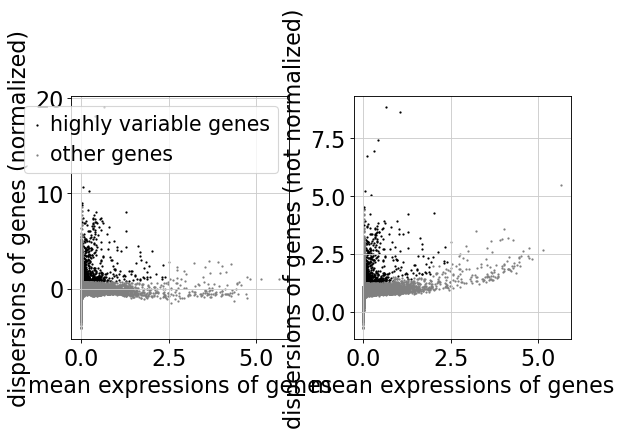

[1141, 36601]


In [6]:
filter_result = sc.pp.filter_genes_dispersion(
    adata.X, min_mean=0.0125, max_mean=2.5, min_disp=0.7)
sc.pl.filter_genes_dispersion(filter_result)
print([sum([i[0] for i in filter_result]),len(filter_result)])

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:375: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:01)


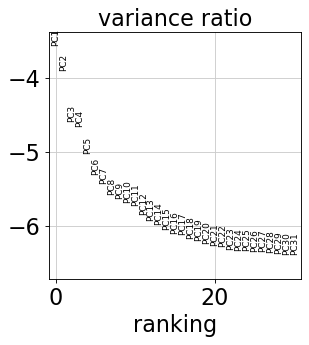

In [7]:
adata = adata[:, filter_result.gene_subset]
adata = adata[:,~adata.var.index.isin([x for x in adata.var.index if x[:4] in ['TRAV', 'TRBV']])]
sc.pp.log1p(adata)
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata)
adata.obsm['X_pca'] *= -1  # multiply by -1 to match Seurat
sc.pl.pca_variance_ratio(adata, log=True)

In [8]:
sc.external.pp.bbknn(adata, batch_key='sample')
sc.tl.umap(adata, spread=1)
sc.tl.leiden(adata, resolution=1)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


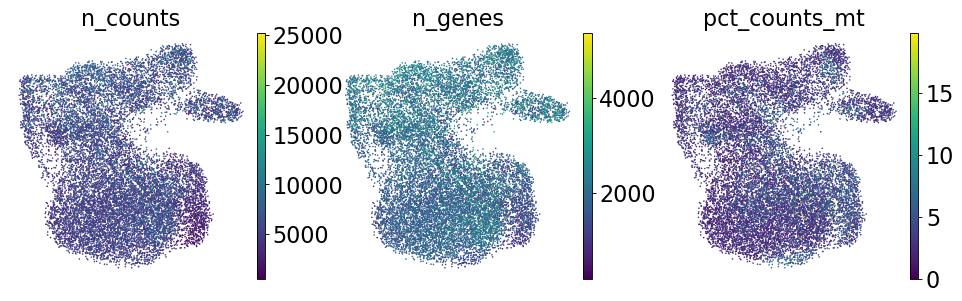

In [9]:
sc.pl.umap(adata, color=['n_counts', 'n_genes', 'pct_counts_mt'], save='qc')

In [10]:
# sc.tl.leiden(adata, resolution=1.4)
sc.tl.leiden(adata, resolution=1.4)

running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


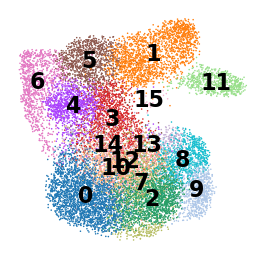

In [11]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', frameon=False, save='abTcell_leiden.pdf')

In [12]:
sc.tl.leiden(adata, resolution=0.4, restrict_to=('leiden', ['11']))

running Leiden clustering
    finished: found 17 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


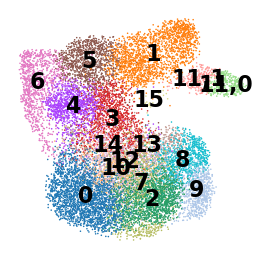

In [13]:
sc.pl.umap(adata, color='leiden_R', legend_loc='on data', title='', frameon=False, save='abTcell_leidenR.pdf')

In [14]:
sc.tl.leiden(adata, resolution=0.4, restrict_to=('leiden_R', ['1']))

running Leiden clustering
    finished: found 18 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


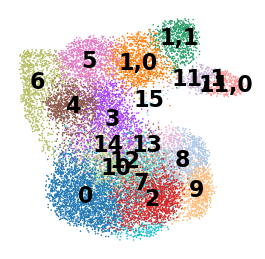

In [15]:
sc.pl.umap(adata, color='leiden_R', legend_loc='on data', title='', frameon=False, save='abTcell_leidenR.pdf')

In [16]:
sc.tl.leiden(adata, resolution=0.4, restrict_to=('leiden_R', ['7']))

running Leiden clustering
    finished: found 22 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


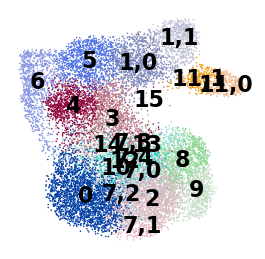

In [17]:
sc.pl.umap(adata, color='leiden_R', legend_loc='on data', title='', frameon=False, save='abTcell_leidenR.pdf')

In [18]:
sc.tl.leiden(adata, resolution=0.8, restrict_to=('leiden_R', ['4','5','6']))

running Leiden clustering
    finished: found 24 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


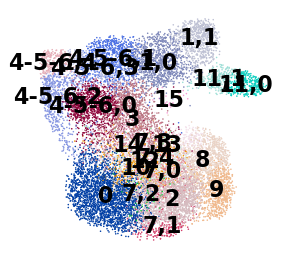

In [19]:
sc.pl.umap(adata, color='leiden_R', legend_loc='on data', title='', frameon=False, save='abTcell_leidenR.pdf')

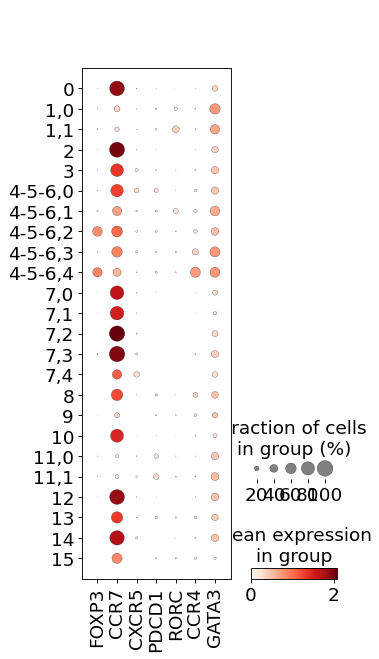

In [20]:
sc.pl.dotplot(adata, ['FOXP3', 'CCR7', 'CXCR5', 'PDCD1', 'RORC', 'CCR4', 'GATA3'], groupby='leiden_R')

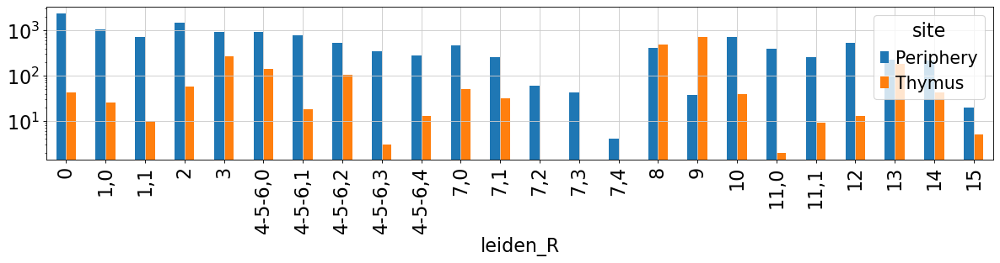

In [21]:
pd.crosstab(adata.obs['site'], adata.obs['leiden_R']).T.plot.bar(figsize=(18,3))
plt.yscale('log')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_R']`


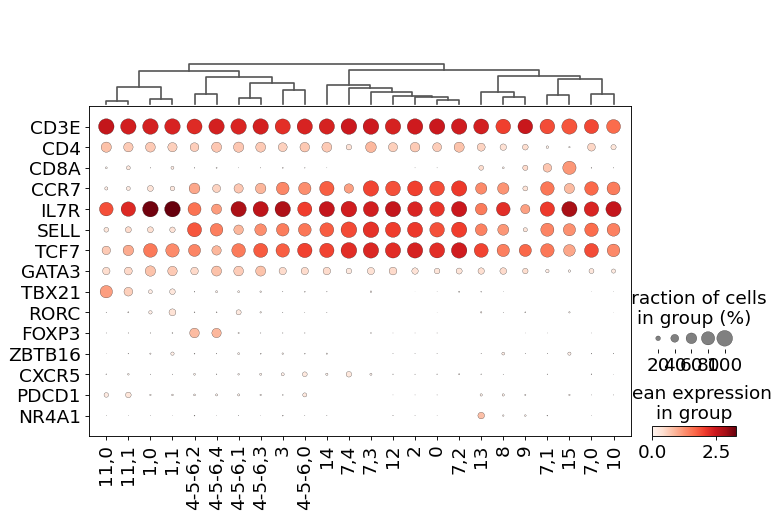

In [22]:
sc.tl.dendrogram(adata, groupby='leiden_R')
sc.pl.dotplot(adata, var_names=['CD3E', 'CD4', 'CD8A', 'CCR7', 'IL7R', 'SELL', 'TCF7', 'GATA3', 'TBX21', 
                                'RORC', 'FOXP3', 'ZBTB16', 
                                'CXCR5', 'PDCD1', 'NR4A1'], 
              groupby='leiden_R', swap_axes=True, dendrogram=True)

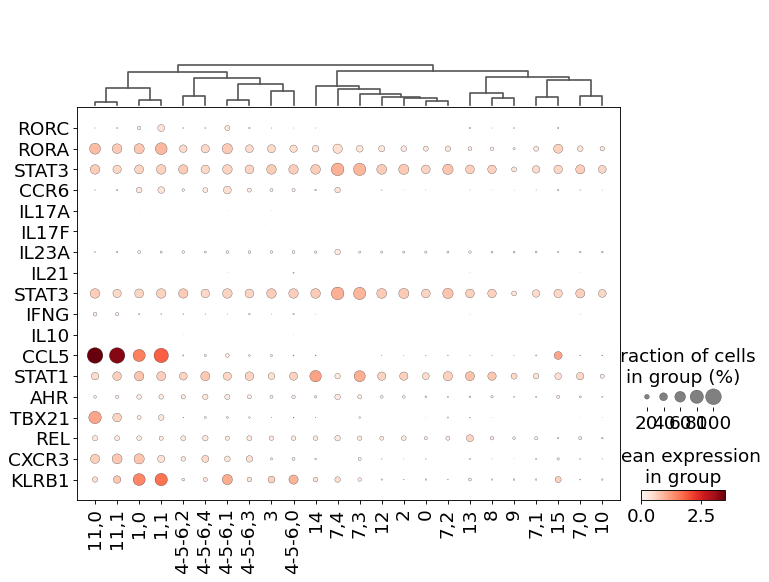

In [23]:
list_th17 = ['RORC', 'RORA', 'STAT3', 'CCR6', 'IL17A', 'IL17F', 'IL23A', 'IL21', 
             'STAT3', 'IFNG', 'IL10', 'CCL5', 'STAT1', 'AHR', 'TBX21', 'REL', 'CXCR3', 'KLRB1']
sc.pl.dotplot(adata, var_names=list_th17, 
              groupby='leiden_R', swap_axes=True, save='leiden_R_Th17', dendrogram=True)

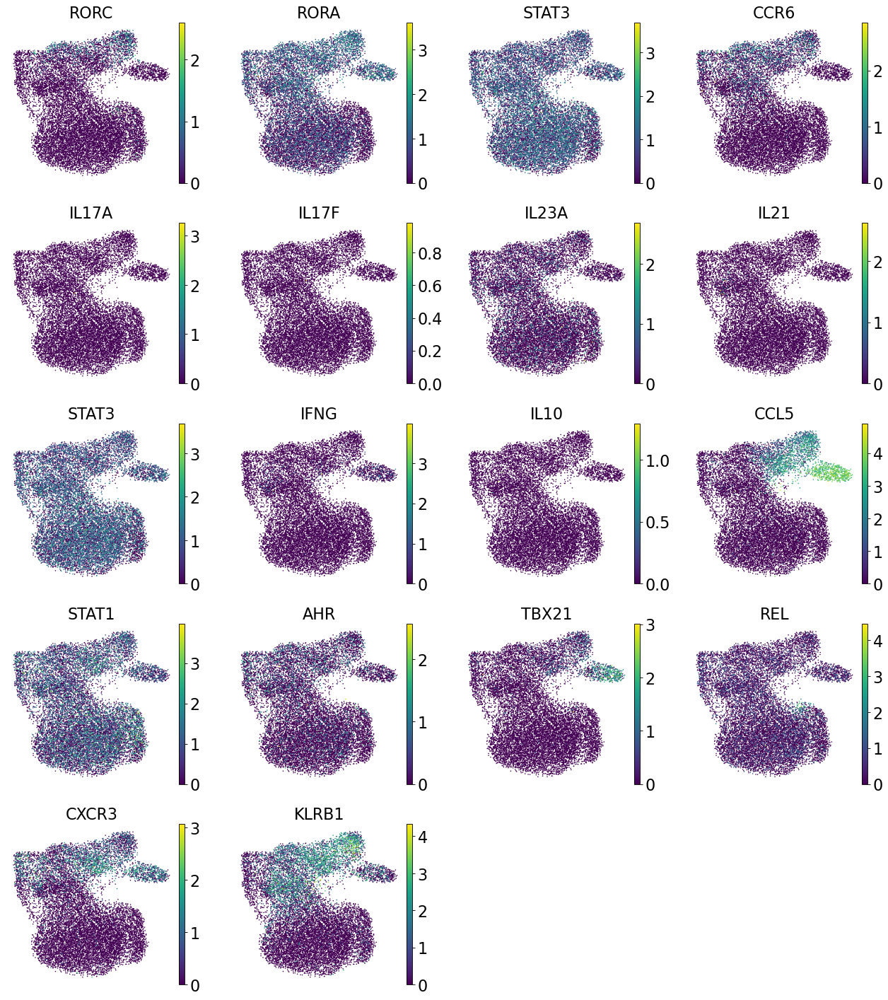

In [24]:
sc.pl.umap(adata, color=list_th17)

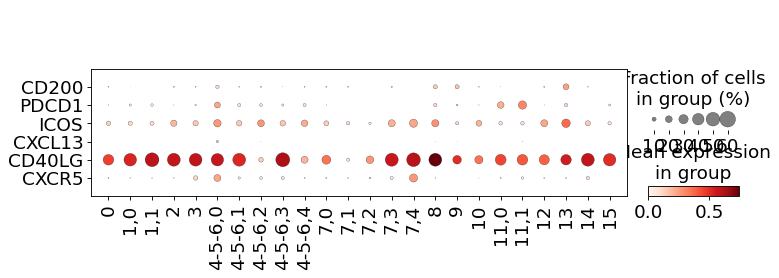

In [25]:
sc.pl.dotplot(adata, var_names=['CD200', 'PDCD1', 'ICOS', 'CXCL13', 'CD40LG', 'CXCR5'], 
              groupby='leiden_R', swap_axes=True, save='leiden_R_TFH')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


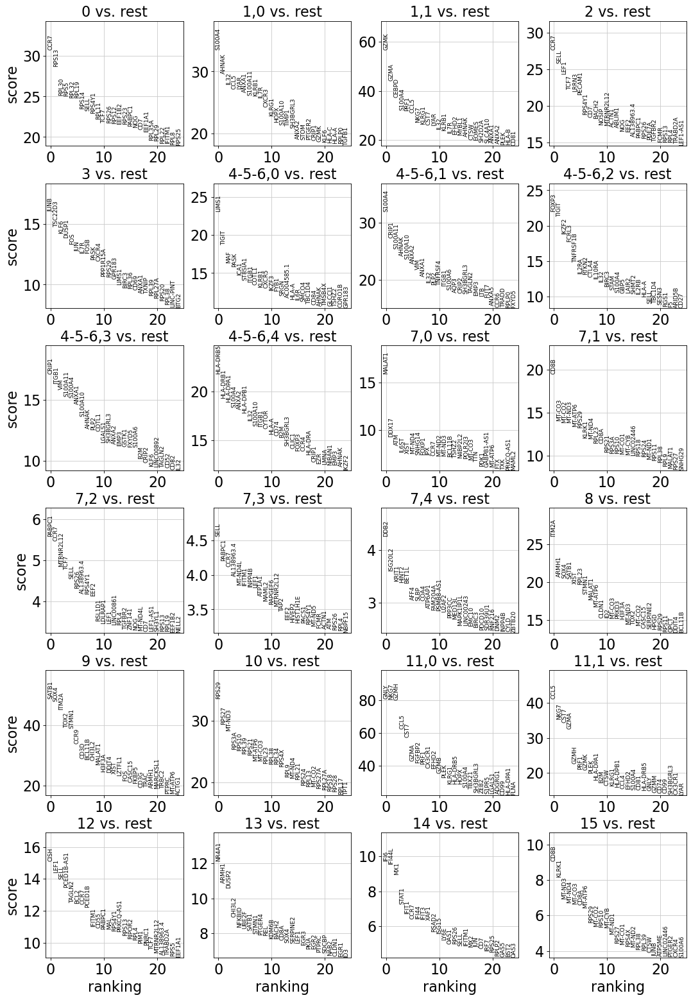

In [26]:
sc.tl.rank_genes_groups(adata, 'leiden_R', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [27]:
print('\n'.join(list(adata.uns['rank_genes_groups']['names']['1,1'])[:100]))

GZMK
GZMA
CEBPD
S100A4
PRF1
CCL5
NKG7
KLRG1
CST7
LYAR
IL32
KLRB1
IL7R
EFHD2
MYBL1
AHNAK
CTSW
EOMES
SH2D2A
SLC4A10
ANXA1
ANXA2
PLEK
HLA-B
CD81
HOPX
HLA-C
CLIC1
TGFB1
ERN1
SYNE2
LTK
S100A11
B2M
SYTL2
HLA-A
GYG1
SH3BGRL3
LGALS3
PHACTR2
S1PR5
BHLHE40
GPR65
ADRB2
ALOX5AP
CD74
RORC
AUTS2
S100A6
MATK
CCR2
GBP5
XBP1
RORA
CYBA
MYO1F
DPP4
RPLP0
GNLY
PLCB1
STOM
AQP3
RHOC
CXCR6
FLNA
NCR3
NFKBIA
PRDM1
PARP8
NSG1
IL18R1
CALM1
PTGER2
IL18RAP
HCST
FKBP11
TGFBR3
PAXX
MT-ND5
ACTN4
CDC42EP3
YWHAQ
CMC1
KLF6
S100A10
IFNGR1
EML4
YWHAH
DHRS7
ABCB1
CTSH
SAMD3
KIF5C
DUSP1
CYB561
CAPN2
PRR5
CAST
CCR6
LCP1


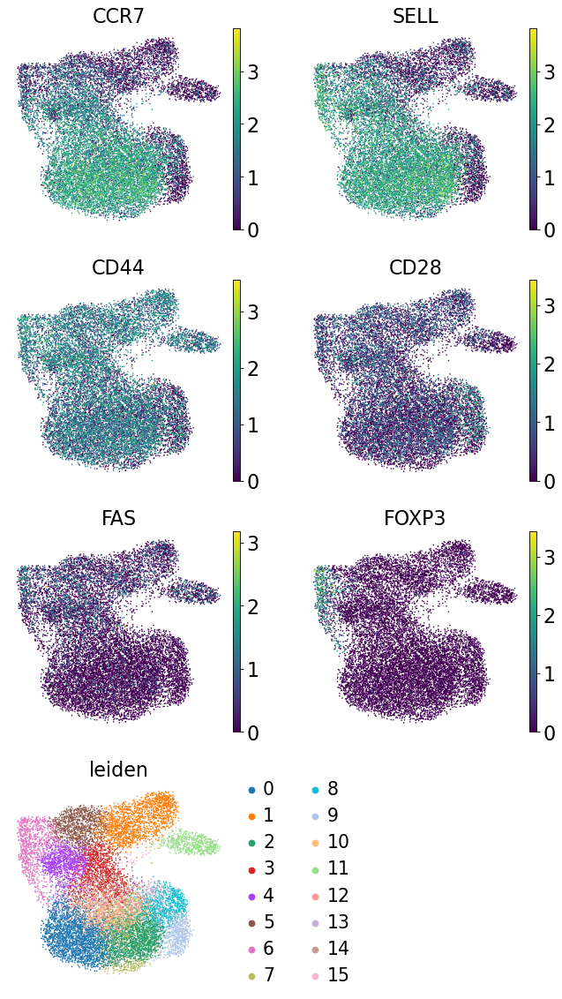

In [28]:
sc.pl.umap(adata,color=['CCR7', 'SELL', 'CD44', 'CD28', 'FAS', 'FOXP3', 'leiden'], ncols=2)

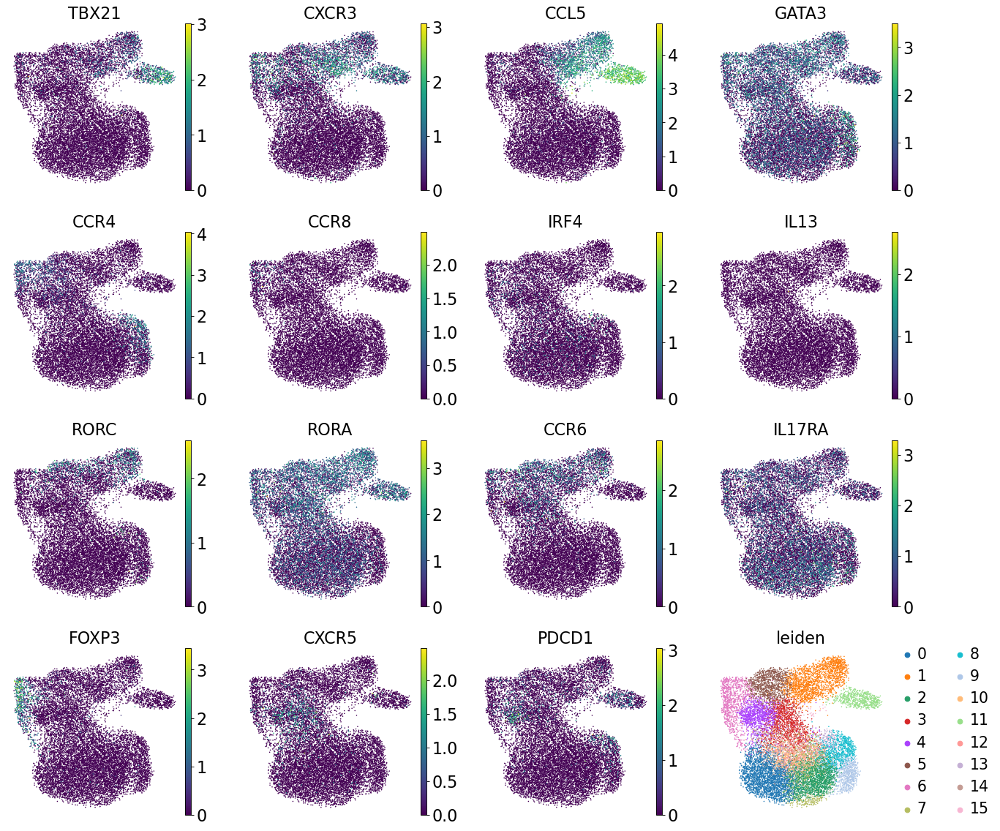

In [29]:
sc.pl.umap(adata,color=['TBX21', 'CXCR3', 'CCL5', 'GATA3', 'CCR4', 'CCR8', 'IRF4', 'IL13', 
                        'RORC', 'RORA', 'CCR6', 'IL17RA', 'FOXP3', 'CXCR5', 'PDCD1', 'leiden'], ncols=4)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


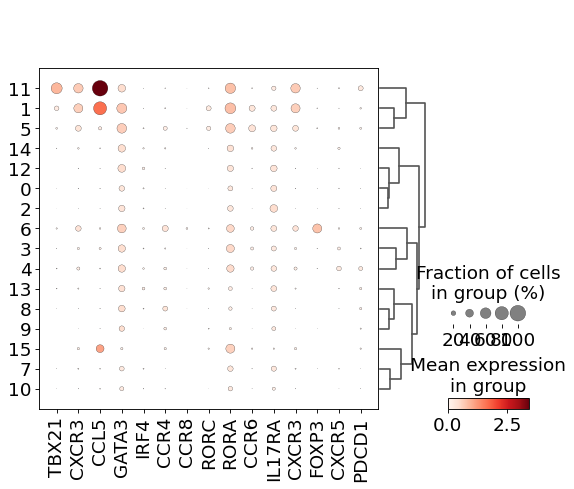

In [30]:
sc.pl.dotplot(adata, ['TBX21', 'CXCR3', 'CCL5', 'GATA3','IRF4', 'CCR4', 'CCR8', 
                        'RORC', 'RORA', 'CCR6', 'IL17RA', 'CXCR3', 'FOXP3', 'CXCR5', 'PDCD1'], groupby='leiden', 
              dendrogram=True)

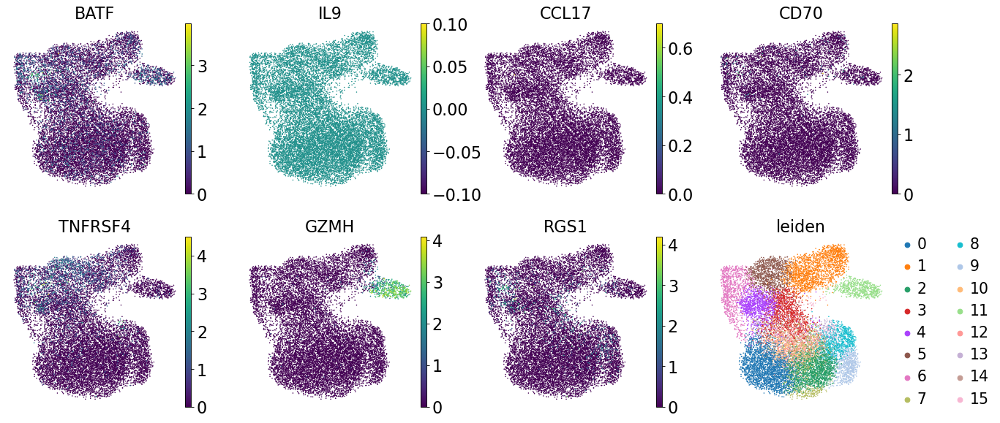

In [31]:
sc.pl.umap(adata,color=['BATF', 'IL9', 'CCL17', 'CD70', 'TNFRSF4', 'GZMH', 'RGS1','leiden'], ncols=4)

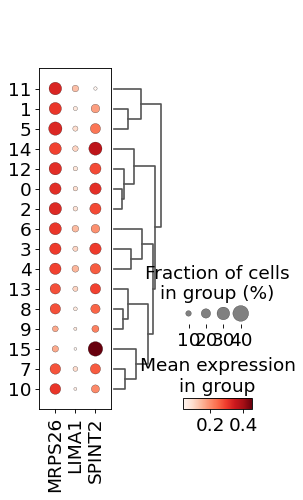

In [32]:
sc.pl.dotplot(adata, ['MRPS26', 'LIMA1', 'SPINT2'], groupby='leiden', 
              dendrogram=True)

Trying to set attribute `.uns` of view, copying.
No handles with labels found to put in legend.


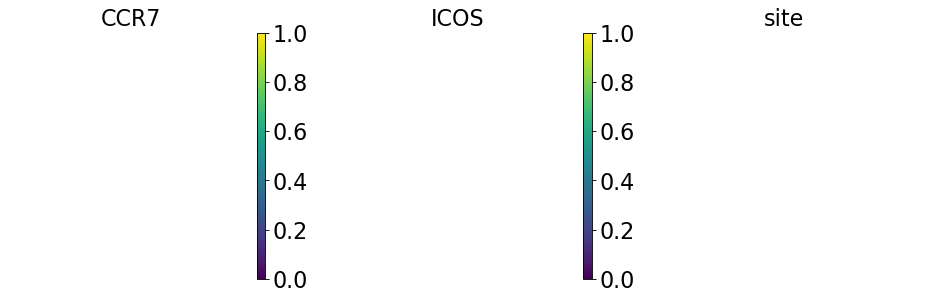

In [33]:
sc.pl.umap(adata[adata.obs['leiden_R']=='4'], color=['CCR7', 'ICOS', 'site'], s=40)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_R']`


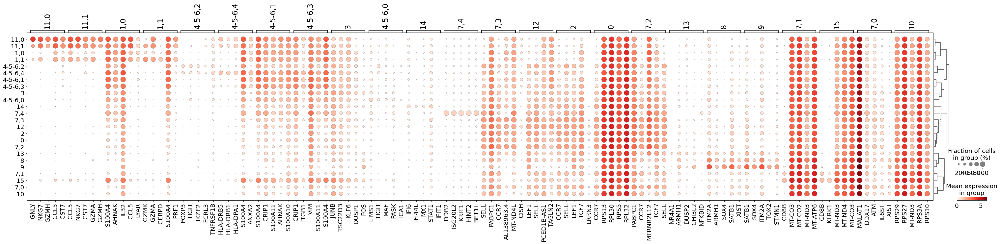

In [34]:
sc.tl.dendrogram(adata, groupby='leiden_R')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby='leiden_R', save=False)

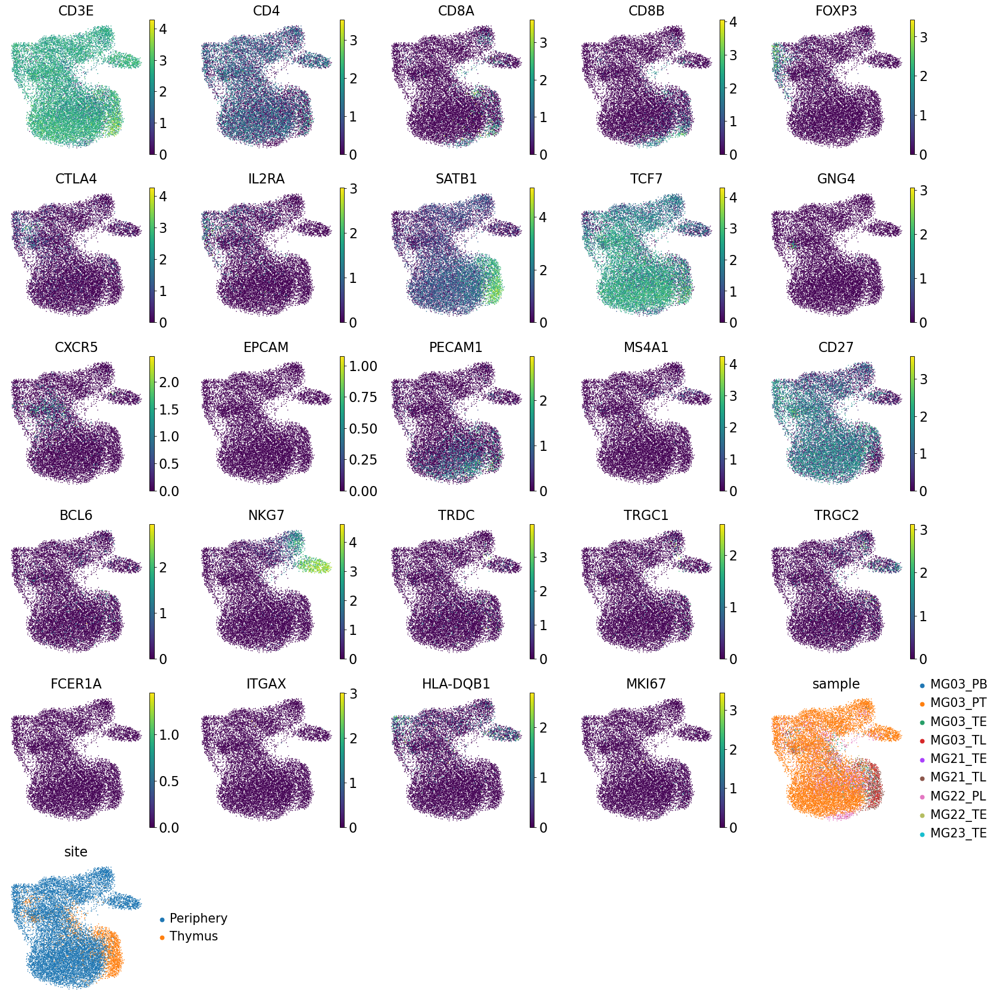

In [35]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['CD3E', 'CD4', 'CD8A', 'CD8B', 'FOXP3', 'CTLA4', 'IL2RA', 'SATB1', 'TCF7', 
                         'GNG4', 'CXCR5',
                         'EPCAM', 'PECAM1', 'MS4A1', 'CD27', 'BCL6',
                         'NKG7', 'TRDC', 'TRGC1', 'TRGC2', 'FCER1A', 'ITGAX', 'HLA-DQB1',
                         'MKI67', 'sample', 'site'],
          save='abT_panel2', ncols=5)

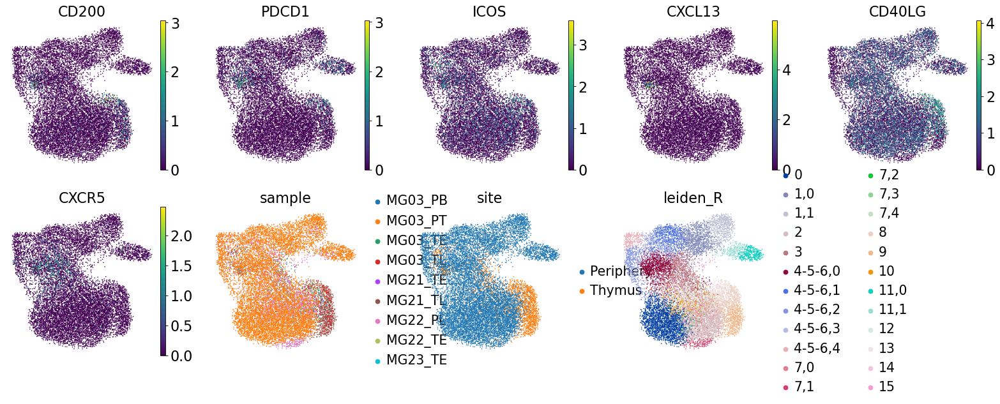

In [36]:

sc.pl.umap(adata, color=['CD200', 'PDCD1', 'ICOS', 'CXCL13', 'CD40LG', 'CXCR5', 
                         'sample', 'site', 'leiden_R'],
          save='abT_TFHpanel', ncols=5)

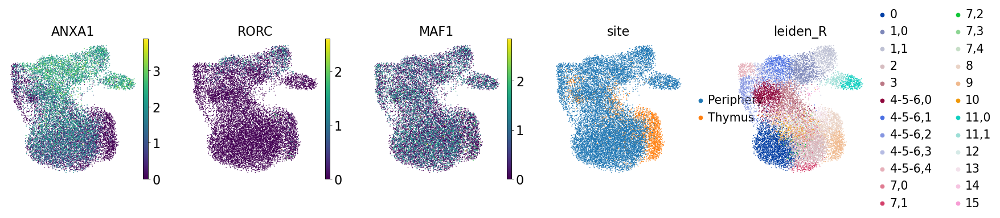

In [37]:

sc.pl.umap(adata, color=['ANXA1', 'RORC', 'MAF1', 'site', 'leiden_R'],
          save=False, ncols=5)

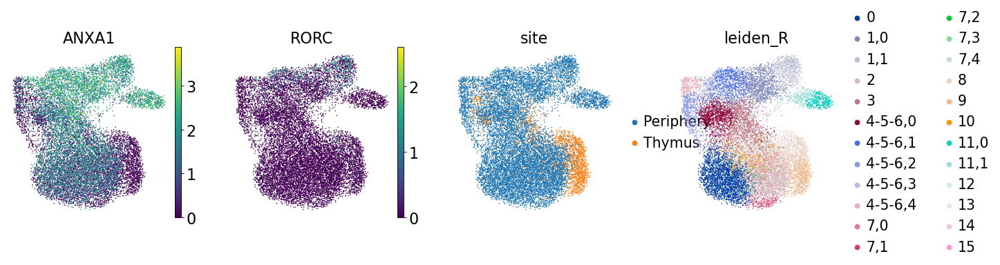

In [38]:

sc.pl.umap(adata, color=['ANXA1', 'RORC', 'site', 'leiden_R'],
          save=False, ncols=5)

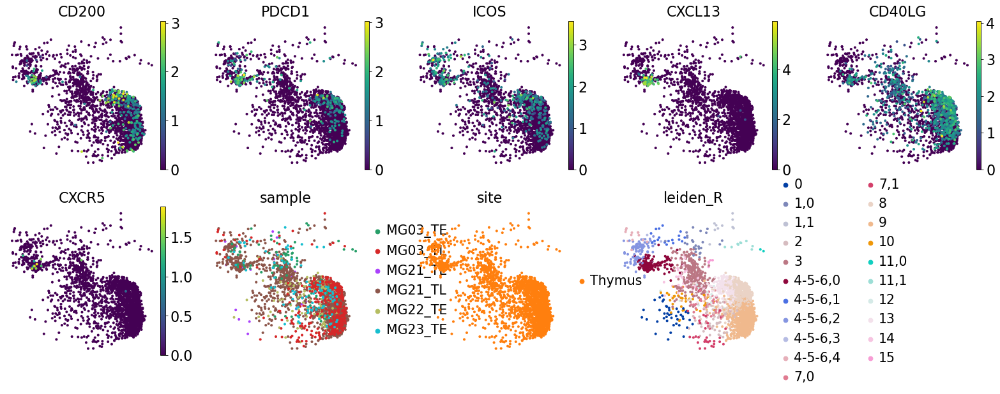

In [39]:
sc.pl.umap(adata[adata.obs['site']=='Thymus'], color=['CD200', 'PDCD1', 'ICOS', 'CXCL13', 
                                                      'CD40LG', 'CXCR5', 'sample', 'site', 'leiden_R'],
          save='thymus_abT_TFHpanel', ncols=5)

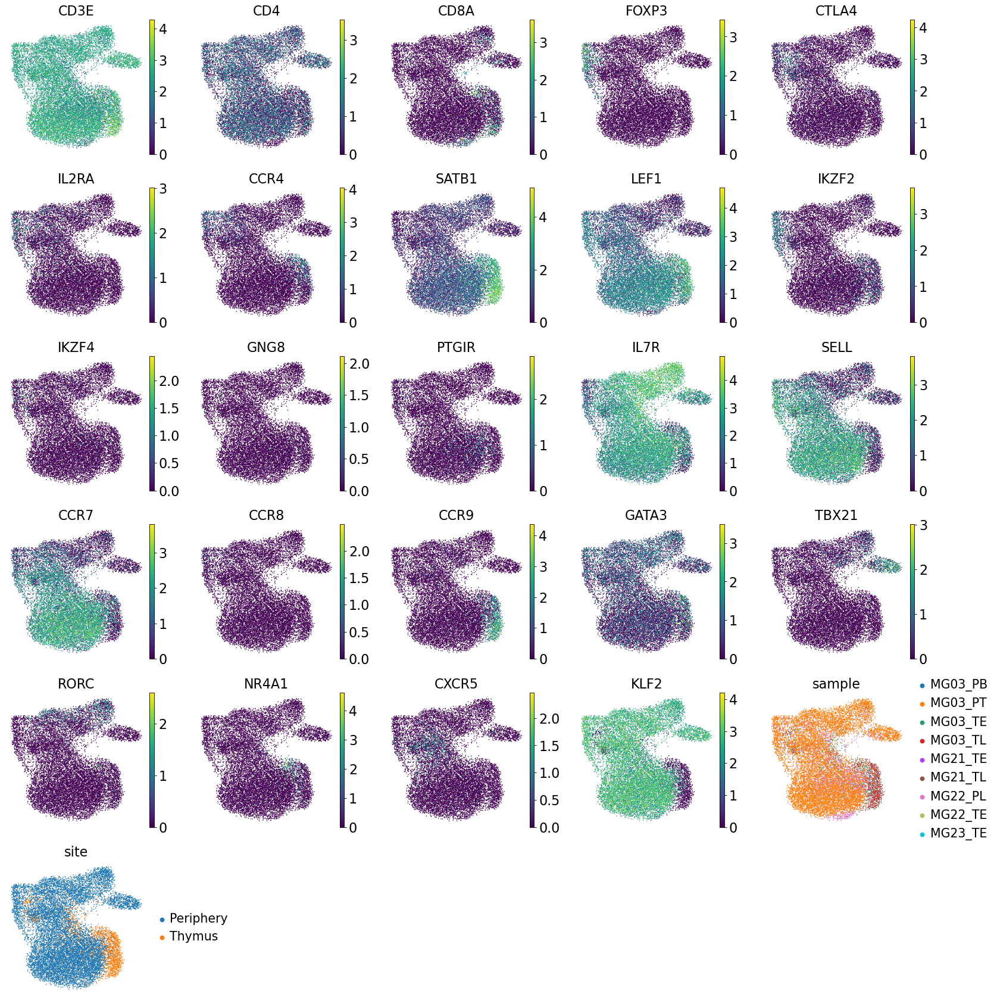

In [40]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['CD3E', 'CD4', 'CD8A', 'FOXP3', 'CTLA4', 'IL2RA', 'CCR4',
                         'SATB1', 'LEF1',
                         'IKZF2', 'IKZF4', 'GNG8', 'PTGIR', 'IL7R', 'SELL', 'CCR7', 'CCR8', 'CCR9',
                         'GATA3', 'TBX21', 'RORC', 'NR4A1',
                         'CXCR5', 'KLF2', 'sample', 'site'],
          save='abT_panel_Treg', ncols=5)

In [41]:
adata[adata.obs['site']=='Thymus']

View of AnnData object with n_obs × n_vars = 2266 × 1053
    obs: 'sample', 'sample_type', 'site', 'fraction', 'n_genes', 'individual', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_R'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'leiden_R_colors', 'dendrogram_leiden_R', 'rank_genes_groups', 'dendrogram_leiden', 'sample_colors', 'site_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

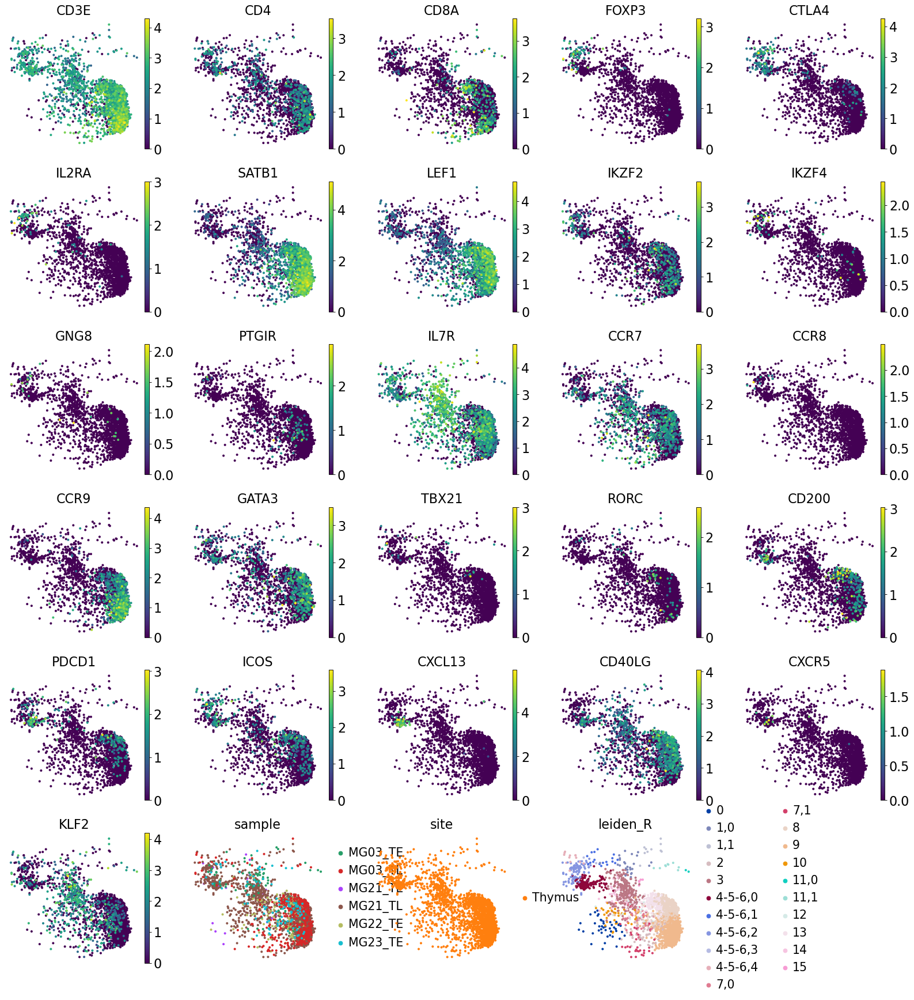

In [42]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata[adata.obs['site']=='Thymus'], color=['CD3E', 'CD4', 'CD8A', 'FOXP3', 'CTLA4', 'IL2RA', 'SATB1', 'LEF1',
                         'IKZF2', 'IKZF4', 'GNG8', 'PTGIR', 'IL7R', 'CCR7', 'CCR8', 'CCR9', 'GATA3', 'TBX21', 'RORC',
                         'CD200', 'PDCD1', 'ICOS', 'CXCL13', 'CD40LG', 'CXCR5', 'KLF2', 'sample', 'site', 'leiden_R'],
          save='abT_panel_Treg_thymus', ncols=5)

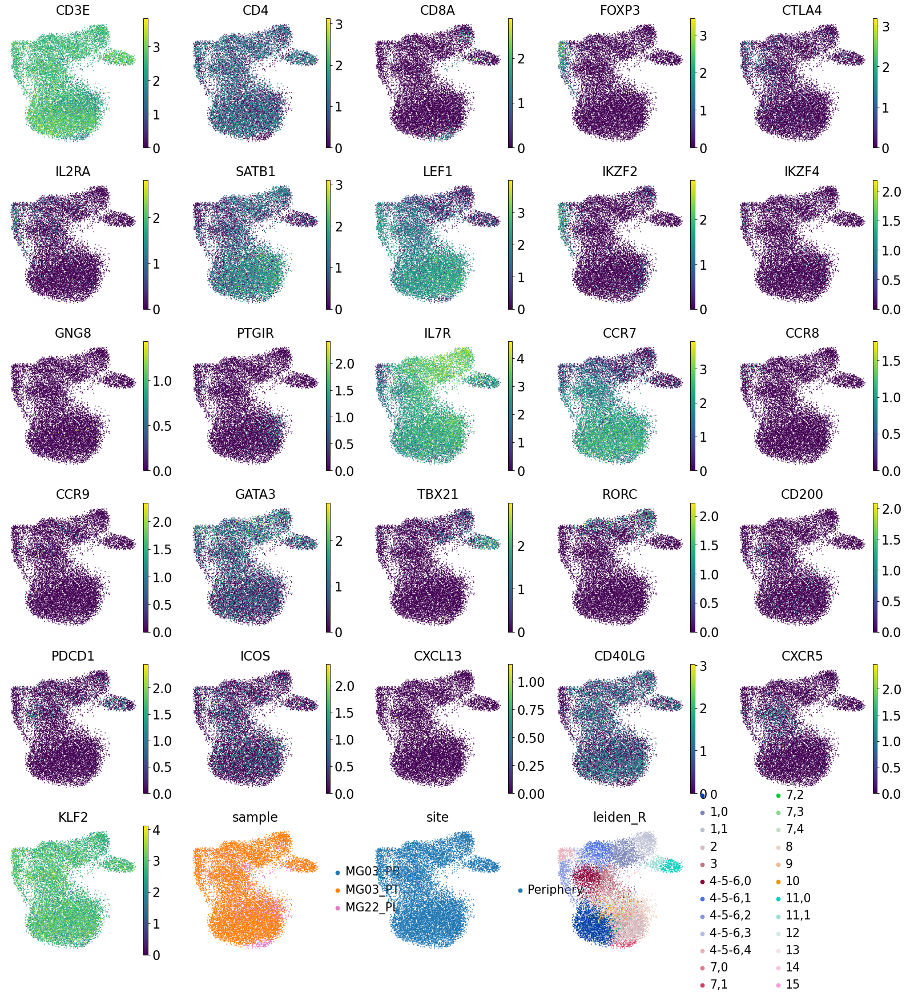

In [43]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata[adata.obs['site']=='Periphery'], color=['CD3E', 'CD4', 'CD8A', 'FOXP3', 'CTLA4', 'IL2RA', 'SATB1', 'LEF1',
                         'IKZF2', 'IKZF4', 'GNG8', 'PTGIR', 'IL7R', 'CCR7', 'CCR8', 'CCR9', 'GATA3', 'TBX21', 'RORC',
                         'CD200', 'PDCD1', 'ICOS', 'CXCL13', 'CD40LG', 'CXCR5', 'KLF2', 'sample', 'site', 'leiden_R'],
          save='abT_panel_Treg_periphery', ncols=5)

computing density on 'umap'
--> added
    'umap_density_site', densities (adata.obs)
    'umap_density_site_params', parameter (adata.uns)
/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/scanpy/plotting/_tools/__init__.py:1186: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("YlOrRd").copy()
  color_map.set_over('black')
/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/scanpy/plotting/_tools/__init__.py:1187: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("YlO

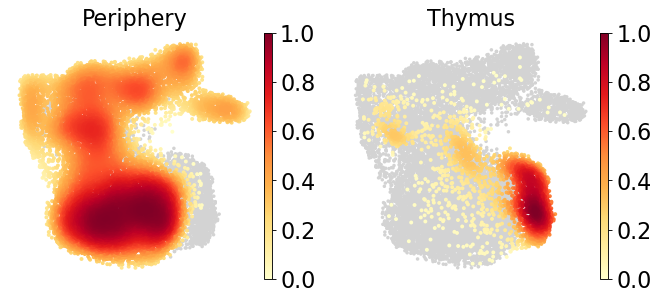

In [44]:
sc.tl.embedding_density(adata, basis='umap', groupby='site')
sc.pl.embedding_density(adata, groupby='site', bg_dotsize=40, fg_dotsize=50, save='CD4T_site')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


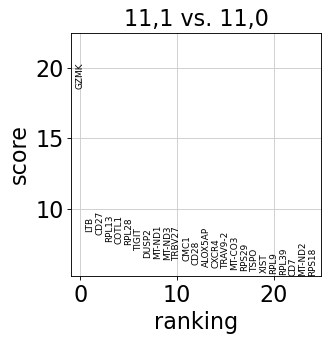

In [45]:
sc.tl.rank_genes_groups(adata, 'leiden_R', method='t-test_overestim_var', 
                        reference='11,0', groups=['11,1'])
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


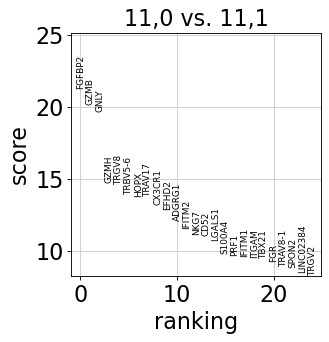

In [46]:
sc.tl.rank_genes_groups(adata, 'leiden_R', method='t-test_overestim_var', 
                        reference='11,1', groups=['11,0'])
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

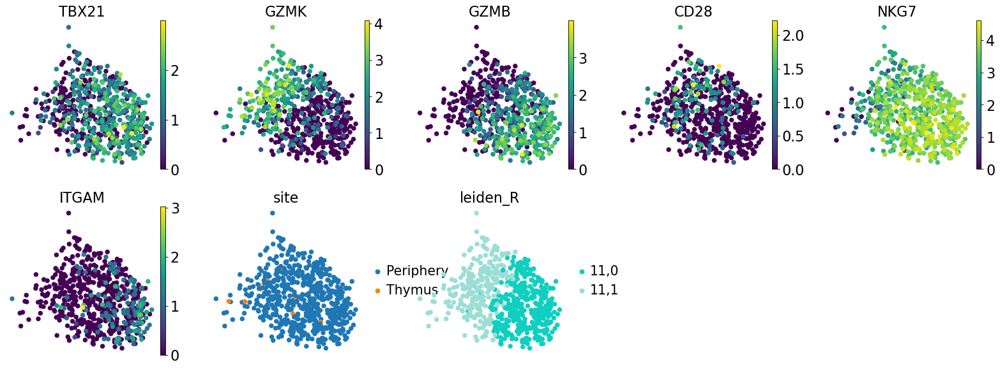

In [47]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata[adata.obs['leiden']=='11'], color=['TBX21', 'GZMK', 'GZMB', 'CD28', 'NKG7', 'ITGAM', 'site', 'leiden_R'],
          save=False, ncols=5)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


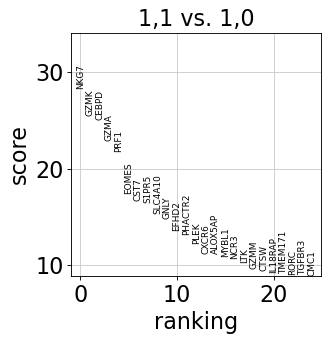

In [48]:
sc.tl.rank_genes_groups(adata, 'leiden_R', method='t-test_overestim_var', 
                        reference='1,0', groups=['1,1'])
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


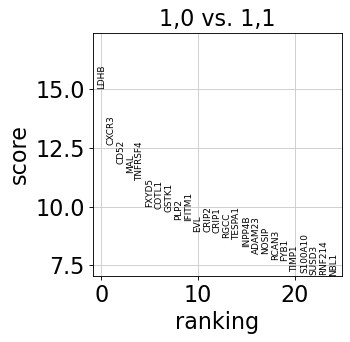

In [49]:
sc.tl.rank_genes_groups(adata, 'leiden_R', method='t-test_overestim_var', 
                        reference='1,1', groups=['1,0'])
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

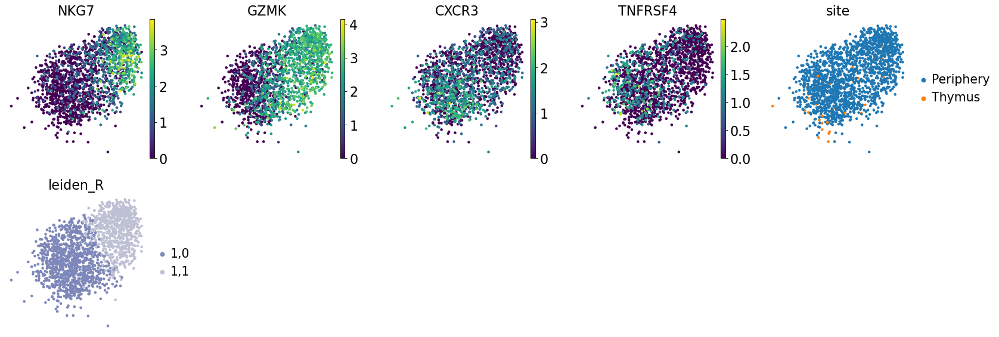

In [50]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata[adata.obs['leiden']=='1'], color=['NKG7', 'GZMK', 'CXCR3', 'TNFRSF4', 'site', 'leiden_R'],
          save=False, ncols=5)

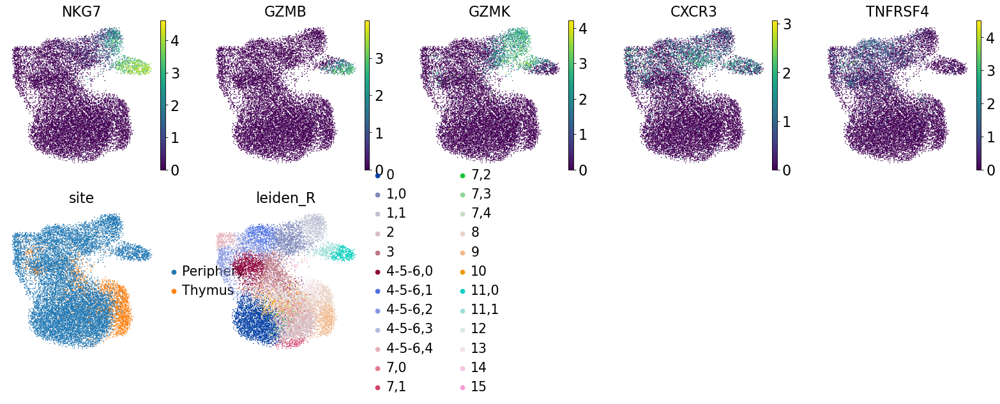

In [51]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['NKG7', 'GZMB', 'GZMK', 'CXCR3', 'TNFRSF4', 'site', 'leiden_R'],
          save=False, ncols=5)

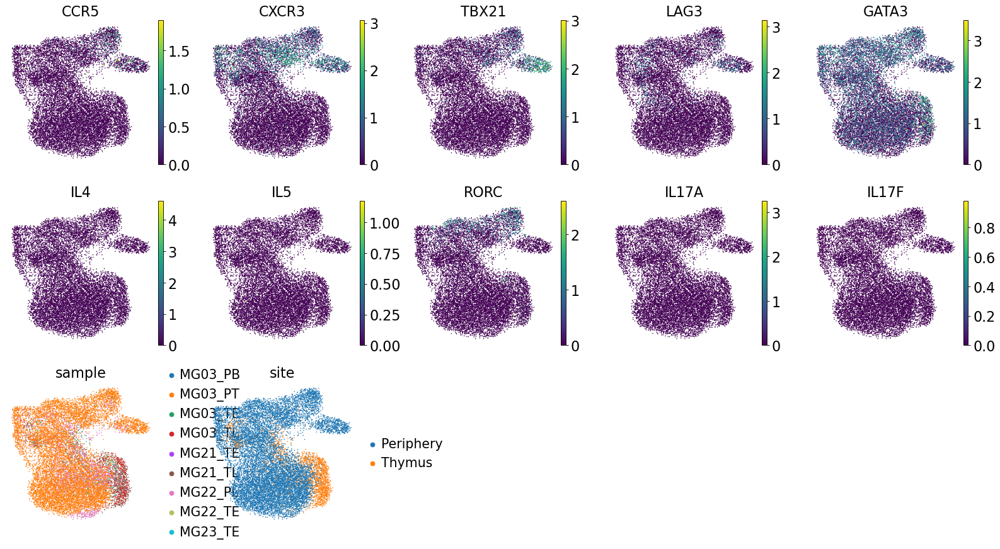

In [52]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['CCR5', 'CXCR3', 'TBX21', 'LAG3', 'GATA3', 'IL4', 'IL5', 
                         'RORC', 'IL17A', 'IL17F', 'sample', 'site'],
          save='Th1_2_17', ncols=5)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_R']`


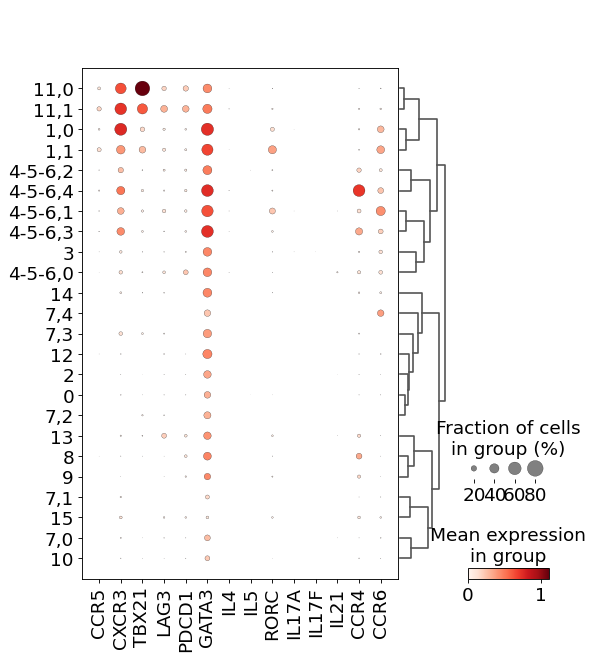

In [53]:
sc.tl.dendrogram(adata, groupby='leiden_R')
sc.pl.dotplot(adata, ['CCR5', 'CXCR3', 'TBX21', 'LAG3', 'PDCD1', 'GATA3', 'IL4', 'IL5', 
                         'RORC', 'IL17A', 'IL17F', 'IL21', 'CCR4', 'CCR6'], dendrogram=True, groupby='leiden_R')

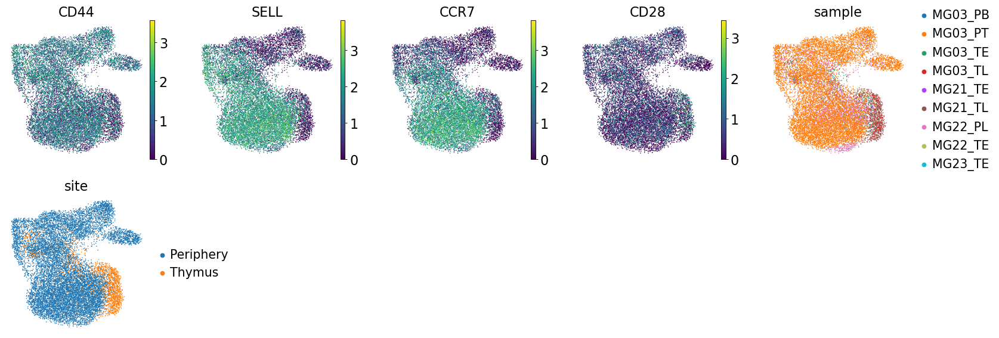

In [54]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['CD44', 'SELL', 'CCR7', 'CD28', 'sample', 'site'],
          save='Thcm', ncols=5)

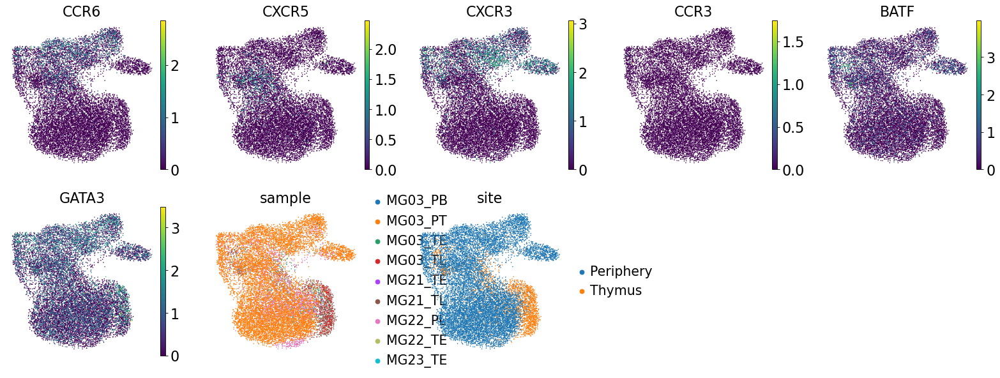

In [55]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['CCR6', 'CXCR5', 'CXCR3', 'CCR3', 'BATF', 'GATA3', 'sample', 'site'],
          save='Th1_2_17', ncols=5)

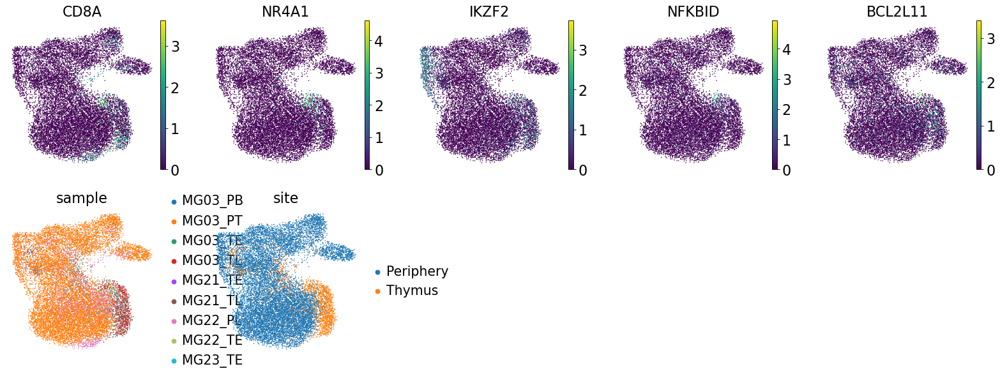

In [56]:
# ITGAX : CD11C
# CD27 : memory B
sc.pl.umap(adata, color=['CD8A', 'NR4A1', 'IKZF2', 'NFKBID', 'BCL2L11', 'sample', 'site'],
          save=False, ncols=5)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_R']`


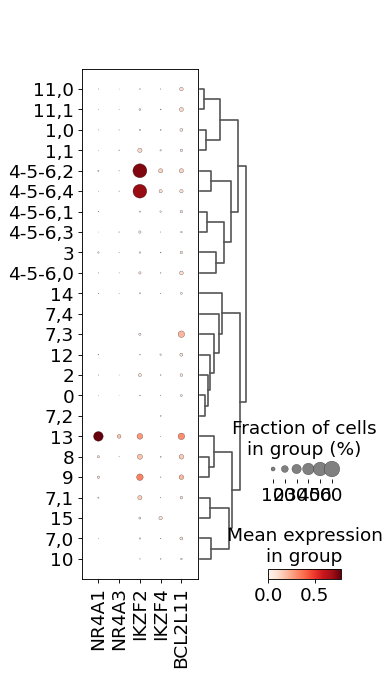

In [57]:
sc.tl.dendrogram(adata, groupby='leiden_R')
sc.pl.dotplot(adata, ['NR4A1', 'NR4A3', 'IKZF2', 'IKZF4', 'BCL2L11'], dendrogram=True, groupby='leiden_R')

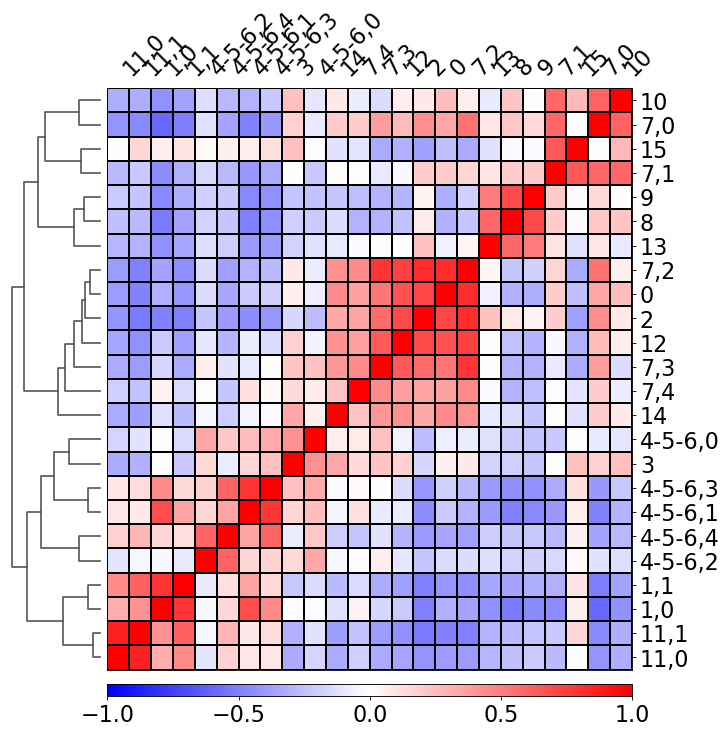

In [58]:
ax = sc.pl.correlation_matrix(adata, 'leiden_R', figsize=(10,10))

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


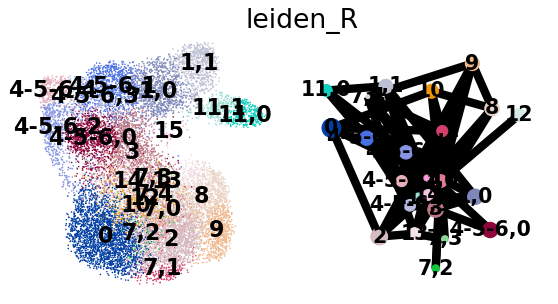

In [59]:
sc.tl.paga(adata, groups='leiden_R')
sc.pl.paga_compare(adata, threshold=1.0, basis='umap')

--> added 'pos', the PAGA positions (adata.uns['paga'])


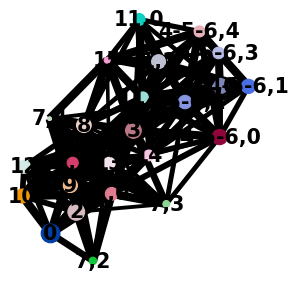

In [60]:
sc.pl.paga(adata, threshold=0.4)

In [61]:
df_clusters =  pd.read_csv('210430_clusters/CD4T_clusters.csv', index_col=0)
df_clusters.index = df_clusters.index.astype(str)
adata.obs['CD4T_cluster'] = [df_clusters.loc[x, 'cluster'] for x in adata.obs['leiden_R']]
df_clusters

,cluster
leiden,
0,CD4 Tnaive
"1,0",CD4 Tem (Th1/17)
"1,1",CD4 Tem (Th1/17)
2,CD4 Tnaive
3,CD4 Tcm (Th0)
"4-5-6,0",CD4 Tcm (Tfh)
"4-5-6,1",CD4 Tcm (Th17)
"4-5-6,2",Naive Treg
"4-5-6,3",CD4 Tcm (Th2)


... storing 'CD4T_cluster' as categorical


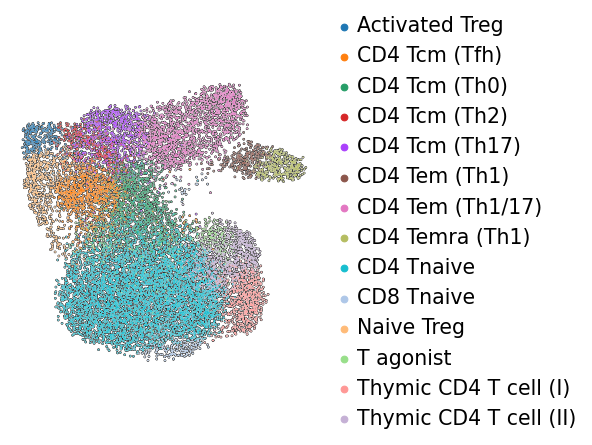

In [62]:
from matplotlib import rcParams

rcParams['figure.figsize'] = 5, 5
sc.pl.umap(adata, color='CD4T_cluster', add_outline=True,
           title='', frameon=False, save='CD4T_cluster.pdf')

sc.settings.set_figure_params(dpi=80, color_map='viridis', transparent=False, frameon=False)  

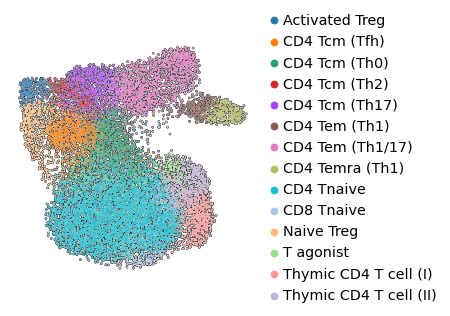

In [63]:
sc.pl.umap(adata, color='CD4T_cluster', title='', add_outline=True, 
           frameon=False, save='CD4T_cluster_out.pdf')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)


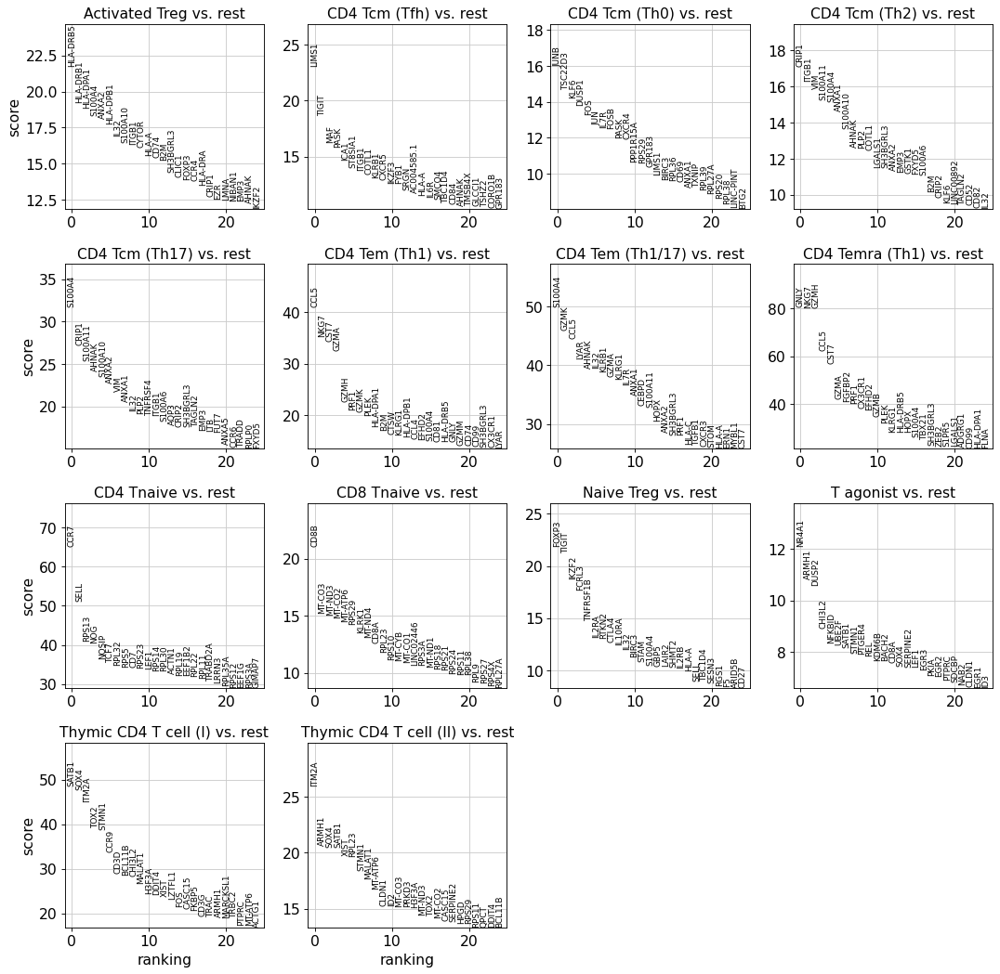

In [64]:
sc.tl.rank_genes_groups(adata, 'CD4T_cluster', method='t-test_overestim_var')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [65]:
print('\n'.join(list(adata.uns['rank_genes_groups']['names']['Activated Treg'])[:100]))

HLA-DRB5
HLA-DRB1
HLA-DPA1
S100A4
ANXA2
HLA-DPB1
IL32
S100A10
ITGB1
CYTOR
HLA-A
CD74
B2M
SH3BGRL3
CLIC1
FOXP3
CCR4
HLA-DRA
CRIP1
EZR
LMNA
NIBAN1
EMP3
AHNAK
IKZF2
CD52
IL10RA
SAMHD1
GBP5
HLA-DQB1
DOK2
ANXA5
TNFRSF1B
GSTK1
FUT7
HLA-C
PI16
S100A6
PFN1
CCR10
GAPDH
ATP2B1
TIGIT
COTL1
FLNA
STAM
LGALS1
LSP1
HLA-B
VIM
LIME1
JPT1
LFNG
TAGLN2
FANK1
MYO1G
YWHAB
LINC02694
CD99
PRDX1
OPTN
CAPN2
ACTN4
FAS
TGFB1
SLC9A3R1
ARPC1B
HLA-DMA
CD58
PBXIP1
LGALS3
HSPA1A
ARHGDIB
SKAP1
CDC25B
RNF214
PPP1CA
S1PR4
OAZ1
CHST7
DUSP4
PLP2
EIF3A
SYNE2
TAP1
IL2RA
IQGAP2
MIR4435-2HG
ELOVL5
SPTAN1
HERPUD1
SELPLG
S100A11
MYO1F
UCP2
OGDH
TTN
C12orf75
CCM2
FTH1


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_CD4T_cluster']`


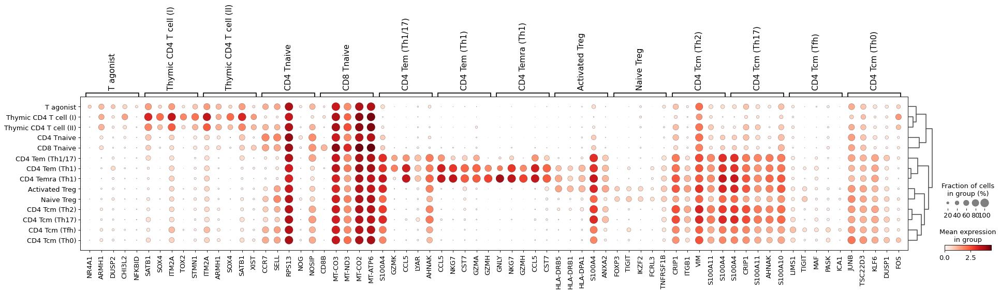

In [66]:
sc.tl.dendrogram(adata, groupby='CD4T_cluster')
sc.pl.rank_genes_groups_dotplot(adata, groupby='CD4T_cluster', n_genes=5)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_CD4T_cluster']`


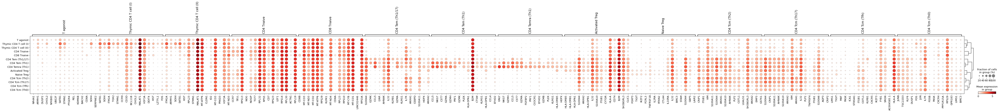

In [67]:
sc.tl.dendrogram(adata, groupby='CD4T_cluster')
sc.pl.rank_genes_groups_dotplot(adata, groupby='CD4T_cluster', n_genes=15, save='CD4T_15')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


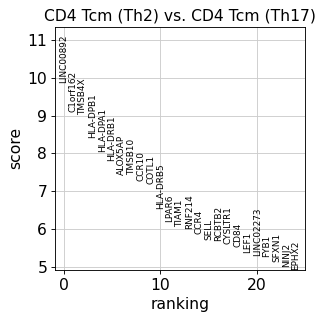

In [68]:
sc.tl.rank_genes_groups(adata, 'CD4T_cluster', method='t-test_overestim_var', groups=['CD4 Tcm (Th2)'], reference='CD4 Tcm (Th17)')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

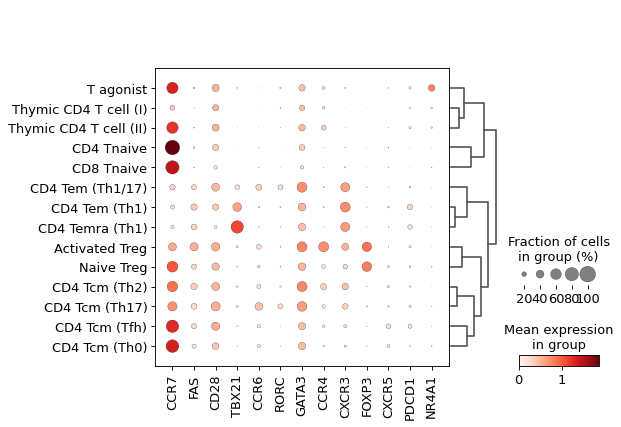

In [70]:
sc.pl.dotplot(adata, ['CCR7', 'FAS', 'CD28', 'TBX21', 'CCR6', 'RORC', 'GATA3', 'CCR4', 'CXCR3',
                      'FOXP3', 'CXCR5', 'PDCD1', 'NR4A1'], 
              groupby='CD4T_cluster', dendrogram=True, save='helper_marker')

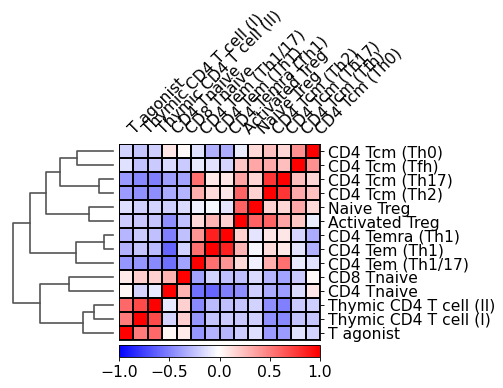

In [71]:
ax = sc.pl.correlation_matrix(adata, 'CD4T_cluster', figsize=(5,3.5))

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


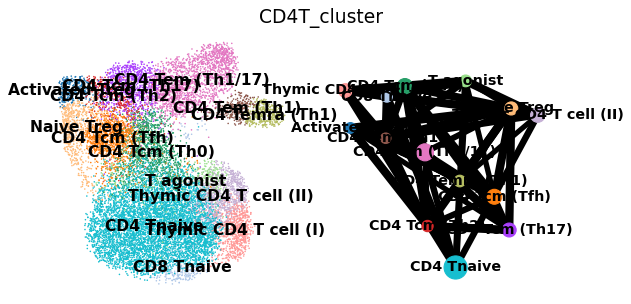

In [72]:
sc.tl.paga(adata, groups='CD4T_cluster')
sc.pl.paga_compare(adata, threshold=0.5, basis='umap')

--> added 'pos', the PAGA positions (adata.uns['paga'])


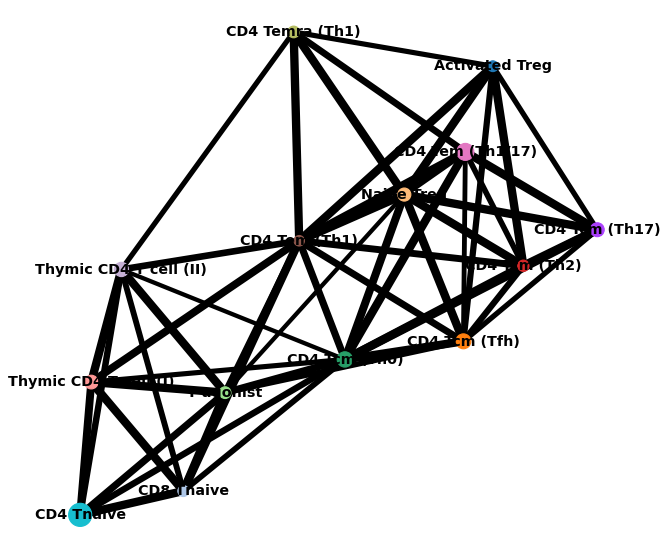

In [73]:
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.paga(adata, threshold=0.5)

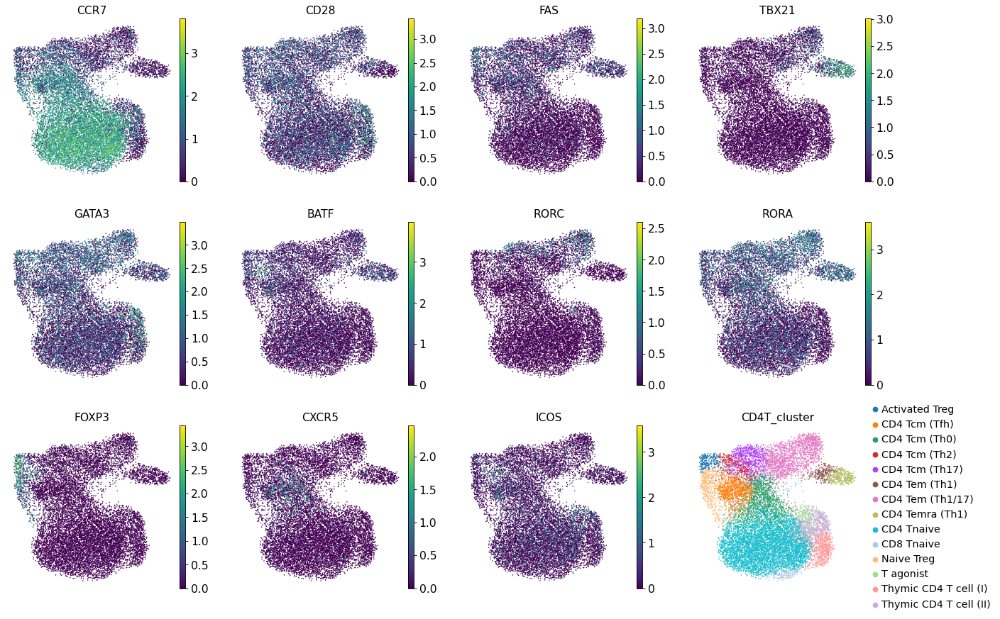

In [74]:
# CCR7 : Tn, Tcm
# CD28 : Tn, Tcm, Ttm
# FAS(CD95) : Tcm, Ttm, Tem
# TBX21(Tbet) : Th1
# GATA3, BATF : Th2
# RORC : Th17
# FOXP3 : Treg
# CXCR5, ICOS : Tfh

list_lineage = ['CCR7', 'CD28', 'FAS', 'TBX21', 'GATA3', 'BATF', 'RORC', 'RORA', 
                'FOXP3', 'CXCR5', 'ICOS']
sc.pl.umap(adata, color=list_lineage+['CD4T_cluster'])

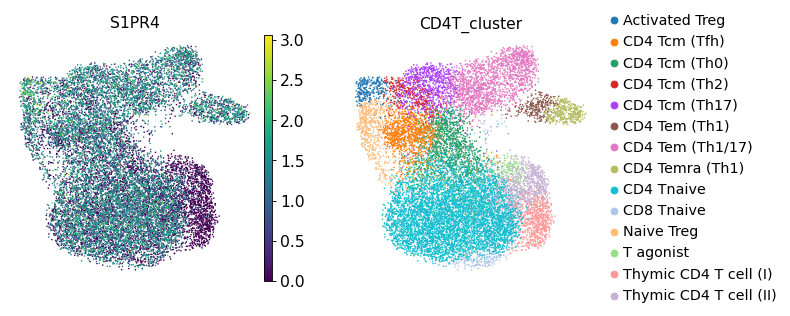

In [75]:
# CCR7 : Tn, Tcm
# CD28 : Tn, Tcm, Ttm
# FAS(CD95) : Tcm, Ttm, Tem
# TBX21(Tbet) : Th1
# GATA3, BATF : Th2
# RORC : Th17
# FOXP3 : Treg
# CXCR5, ICOS : Tfh

list_lineage = ['S1PR4']
sc.pl.umap(adata, color=list_lineage+['CD4T_cluster'])

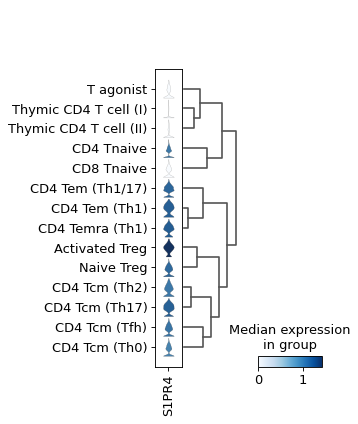

In [76]:
sc.pl.stacked_violin(adata, list_lineage, groupby='CD4T_cluster', dendrogram=True)

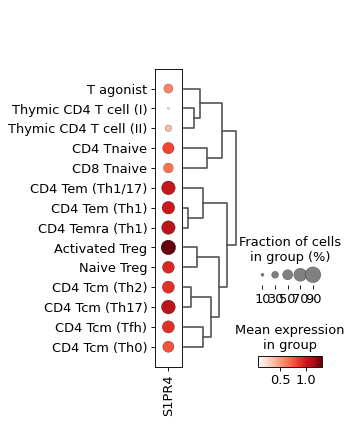

In [77]:
sc.pl.dotplot(adata, list_lineage, groupby='CD4T_cluster', dendrogram=True)

In [78]:
adata

AnnData object with n_obs × n_vars = 15240 × 1053
    obs: 'sample', 'sample_type', 'site', 'fraction', 'n_genes', 'individual', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_R', 'umap_density_site', 'CD4T_cluster'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'leiden_R_colors', 'dendrogram_leiden_R', 'rank_genes_groups', 'dendrogram_leiden', 'sample_colors', 'site_colors', 'umap_density_site_params', 'paga', 'leiden_R_sizes', 'CD4T_cluster_colors', 'dendrogram_CD4T_cluster', 'CD4T_cluster_sizes'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

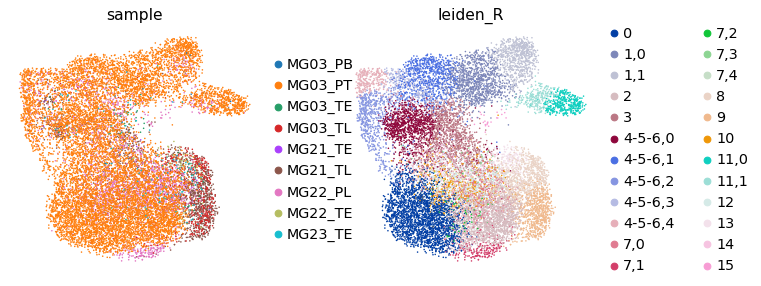

In [79]:
sc.pl.umap(adata, 
           color=['sample', 'leiden_R'], 
           save=False)

<AxesSubplot:xlabel='CD4T_cluster', ylabel='site'>

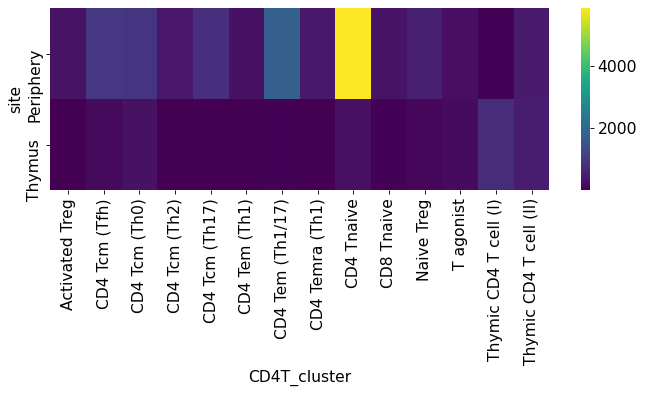

In [80]:
plt.figure(figsize=(10,3))
sns.heatmap(pd.crosstab(adata.obs['site'], adata.obs['CD4T_cluster']), cmap='viridis')

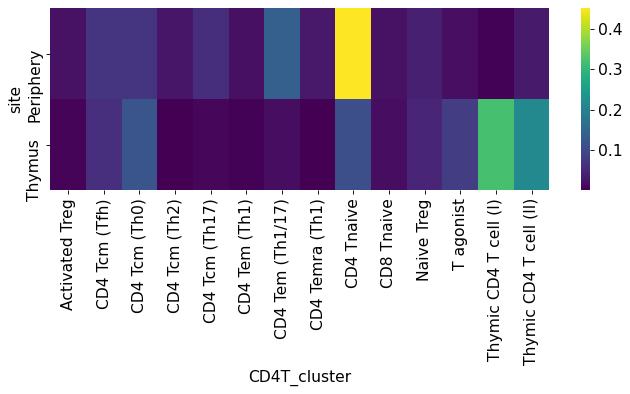

In [81]:
df_cross = pd.crosstab(adata.obs['site'], adata.obs['CD4T_cluster'])
df_cross = (df_cross.T / df_cross.sum(axis=1)).T

plt.figure(figsize=(10,3))
sns.heatmap(df_cross, cmap='viridis')
plt.savefig(str(sc.settings.figdir) + '/heatmap_freq_norm.pdf', bbox_inches='tight')

In [82]:
df_cross = pd.crosstab(adata.obs['site'], adata.obs['CD4T_cluster'])

In [83]:
df_cross = df_cross[['Activated Treg', 'CD4 Tcm (Tfh)', 'CD4 Tcm (Th0)',
                  'CD4 Tcm (Th2)', 'CD4 Tcm (Th17)', 'CD4 Tem (Th1)',
                  'CD4 Tem (Th1/17)', 'CD4 Temra (Th1)', 'CD4 Tnaive',
                  'Naive Treg', 'T agonist',
                  'Thymic CD4 T cell (I)', 'Thymic CD4 T cell (II)']]

In [84]:
list_label = ['Activated Treg', 'CD4 Tcm (Tfh)', 'CD4 Tcm (Th0)',
                  'CD4 Tcm (Th2)', 'CD4 Tcm (Th17)', 'CD4 Tem (Th1)',
                  'CD4 Tem (Th1/17)', 'CD4 Temra (Th1)', 'CD4 Tnaive',
                  'Naive Treg', 'T agonist',
                  'Thymic CD4 T cell (I)', 'Thymic CD4 T cell (II)']

In [85]:
df_cross = pd.crosstab(adata.obs['site'], adata.obs['CD4T_cluster'])
# remove CD8T
df_cross = df_cross[list_label]
# df_cross = (df_cross.T / df_cross.sum(axis=1)).T

In [86]:
import scipy.stats as stats
import statsmodels.stats.multitest as multi

list_pvalue = []
for label in list_label:
    a = df_cross.loc['Periphery', label]
    b = df_cross.loc['Thymus', label]
    c = df_cross.loc['Periphery', list(set(list_label) - set(label))].sum()
    d = df_cross.loc['Thymus', list(set(list_label) - set(label))].sum()
    
    oddsratio, pvalue = stats.fisher_exact([[a, b],[c, d]])
    list_pvalue.append(pvalue)
    
multi.fdrcorrection(list_pvalue)

(array([ True, False,  True,  True,  True,  True,  True,  True,  True,
        False,  True,  True,  True]),
 array([2.62420289e-008, 1.52422054e-001, 6.15160852e-012, 4.75757005e-020,
        1.76628615e-032, 2.70004402e-009, 6.17561195e-072, 6.02263329e-024,
        1.83003103e-129, 1.70034440e-001, 1.49334773e-044, 0.00000000e+000,
        8.29169057e-147]))

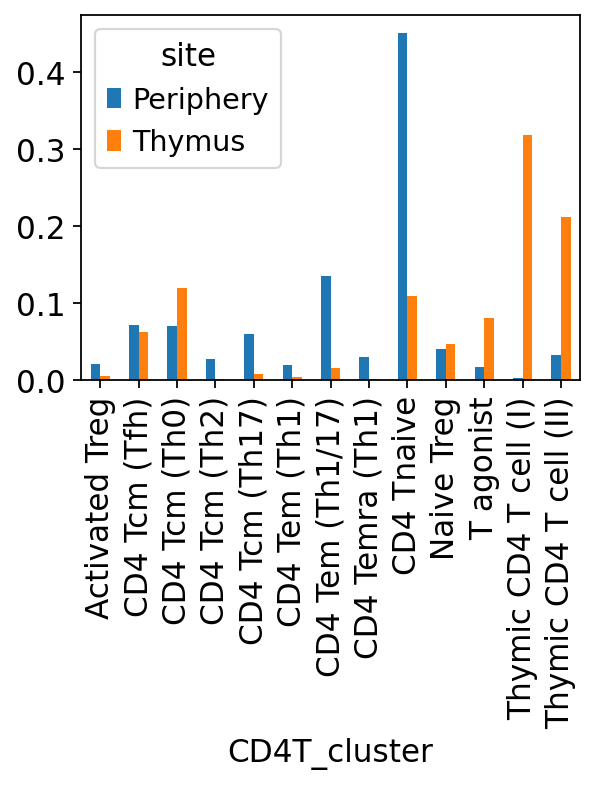

In [135]:
pd.crosstab(adata.obs['site'], adata.obs['CD4T_cluster'], normalize=0).T.loc[list_label].plot.bar(figsize=(4,3))
# plt.yscale('log')
plt.grid(None)

plt.savefig(str(sc.settings.figdir) + '/bar_site.pdf', bbox_inches='tight')

In [117]:
df_cross / df_cross.sum(axis=0)

CD4T_cluster,Activated Treg,CD4 Tcm (Tfh),CD4 Tcm (Th0),CD4 Tcm (Th2),CD4 Tcm (Th17),CD4 Tem (Th1),CD4 Tem (Th1/17),CD4 Temra (Th1),CD4 Tnaive,CD8 Tnaive,Naive Treg,T agonist,Thymic CD4 T cell (I),Thymic CD4 T cell (II)
site,,,,,,,,,,,,,,
Periphery,0.788205,0.533704,0.370282,0.952964,0.883688,0.831343,0.894951,0.971547,0.805587,0.566643,0.460963,0.177579,0.008883,0.130683
Thymus,0.211795,0.466296,0.629718,0.047036,0.116312,0.168657,0.105049,0.028453,0.194413,0.433357,0.539037,0.822421,0.991117,0.869317


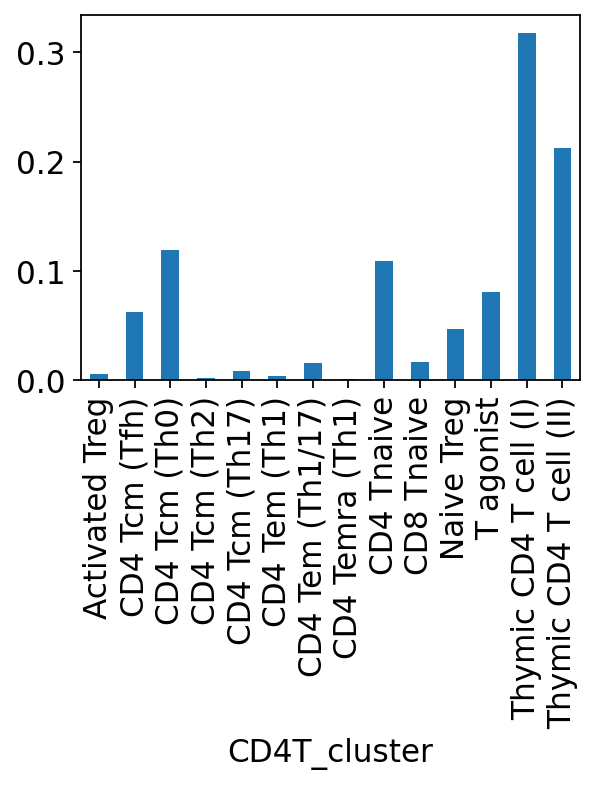

In [118]:
plt.figure(figsize=(4,3))
df_cross.loc['Thymus'].plot.bar()
plt.grid(False)

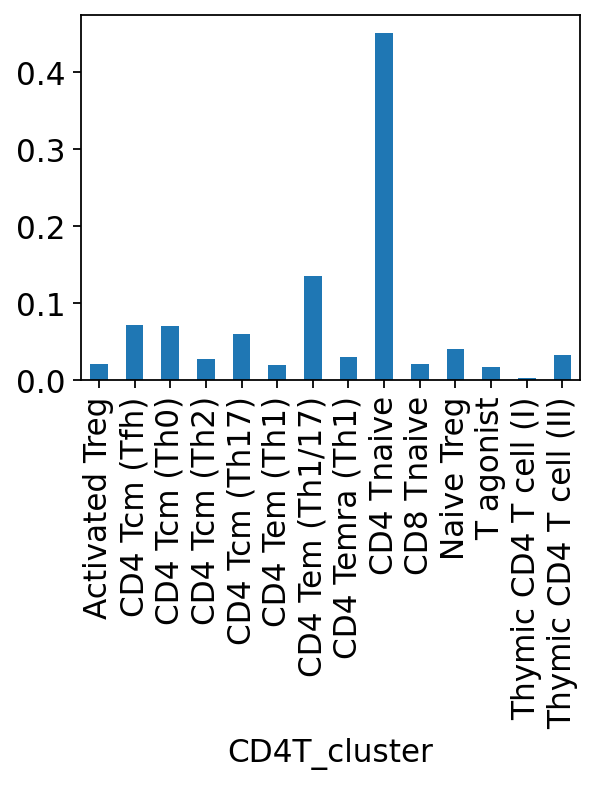

In [119]:
plt.figure(figsize=(4,3))
df_cross.loc['Periphery'].plot.bar()
plt.grid(False)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


<AxesSubplot:xlabel='individual', ylabel='CD4T_cluster'>

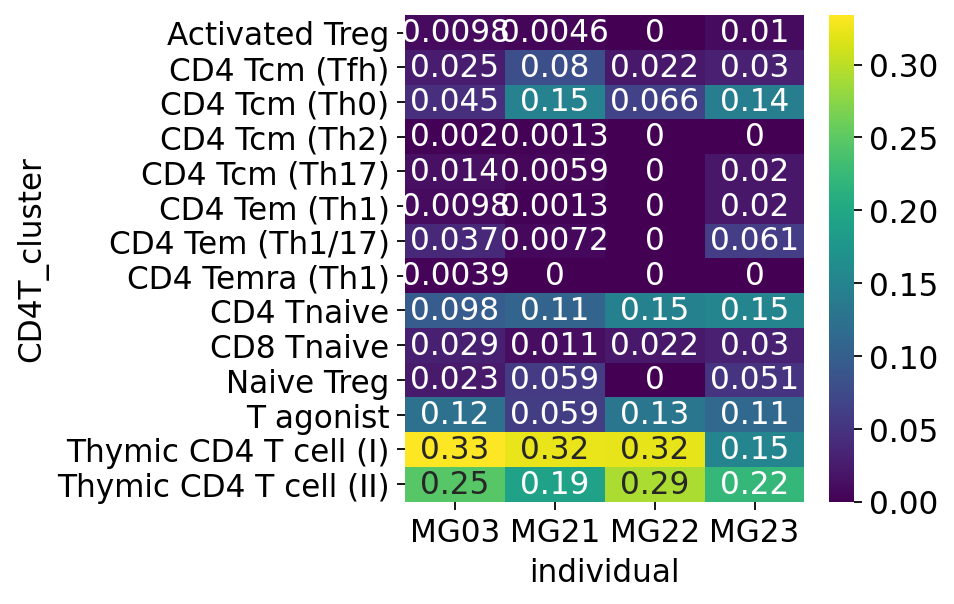

In [83]:
d = adata.obs[adata.obs['site'] == 'Thymus']
d['individual'] = d['individual'].str.split('_').str.get(0)
d = pd.crosstab(d['individual'], d['CD4T_cluster'])
d = d.T / d.sum(axis=1)

sns.heatmap(d, cmap='viridis', annot=True)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


<AxesSubplot:xlabel='individual', ylabel='CD4T_cluster'>

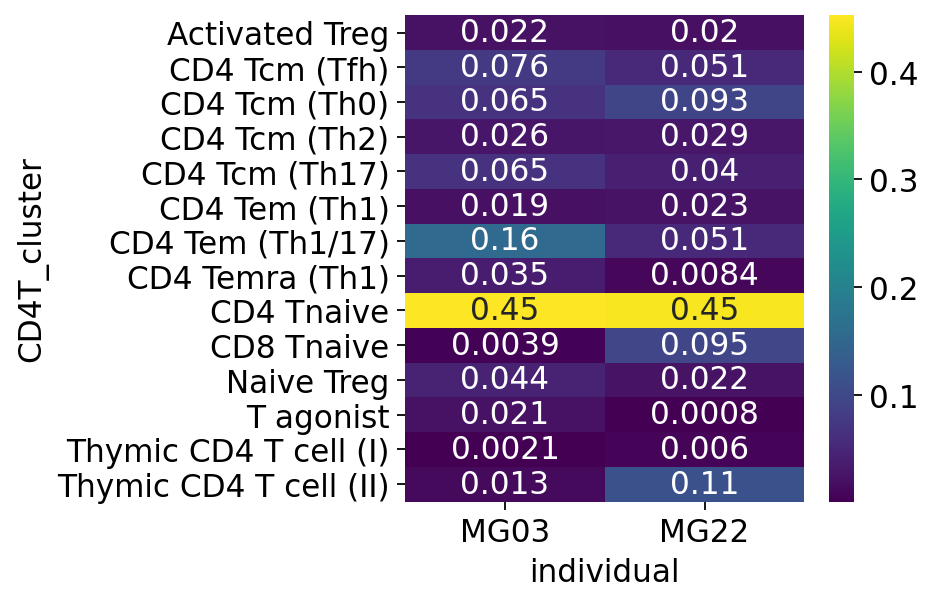

In [84]:
d = adata.obs[adata.obs['site'] == 'Periphery']
d['individual'] = d['individual'].str.split('_').str.get(0)
d = pd.crosstab(d['individual'], d['CD4T_cluster'])
d = d.T / d.sum(axis=1)

sns.heatmap(d, cmap='viridis', annot=True)

In [177]:
import scipy.stats as stats

list_prop = []

d = adata.obs[adata.obs['site'] == 'Thymus']
d['individual'] = d['individual'].str.split('_').str.get(0)
d = pd.crosstab(d['individual'], d['CD4T_cluster'])
d = d[list_label]
d = d.T / d.sum(axis=1)
d = d.reset_index().melt(id_vars='CD4T_cluster')
d['site'] = 'Thymus'

list_prop.append(d)

d = adata.obs[adata.obs['site'] == 'Periphery']
d['individual'] = d['individual'].str.split('_').str.get(0)
d = pd.crosstab(d['individual'], d['CD4T_cluster'])
d = d[list_label]
d = d.T / d.sum(axis=1)
d = d.reset_index().melt(id_vars='CD4T_cluster')
d['site'] = 'Periphery'
list_prop.append(d)

df_prop = pd.concat(list_prop)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


In [186]:
list_p = []
for lab in list_label:
    _, p = stats.ttest_ind(df_prop.loc[(df_prop['site'] == 'Thymus') & (df_prop['CD4T_cluster'] == lab), 'value'],
                      df_prop.loc[(df_prop['site'] == 'Periphery') & (df_prop['CD4T_cluster'] == lab), 'value'])
    list_p.append(p)
multi.fdrcorrection(list_p)

(array([ True, False, False,  True,  True, False, False, False,  True,
        False,  True,  True,  True]),
 array([3.62253907e-02, 3.50070316e-01, 7.37582592e-01, 9.68141151e-04,
        3.62253907e-02, 1.71655475e-01, 1.44886855e-01, 9.47912116e-02,
        9.68141151e-04, 9.80547507e-01, 3.85855559e-02, 3.62253907e-02,
        3.85855559e-02]))

In [188]:
list_p

[0.013932842586753142,
 0.2962133440642472,
 0.6808454697478445,
 0.00010743932536037203,
 0.00942900421103028,
 0.13204267302615455,
 0.10030628405676624,
 0.05833305326928812,
 0.00014894479242640962,
 0.9805475074594803,
 0.019770725682897956,
 0.01292489401412929,
 0.020776837814503662]

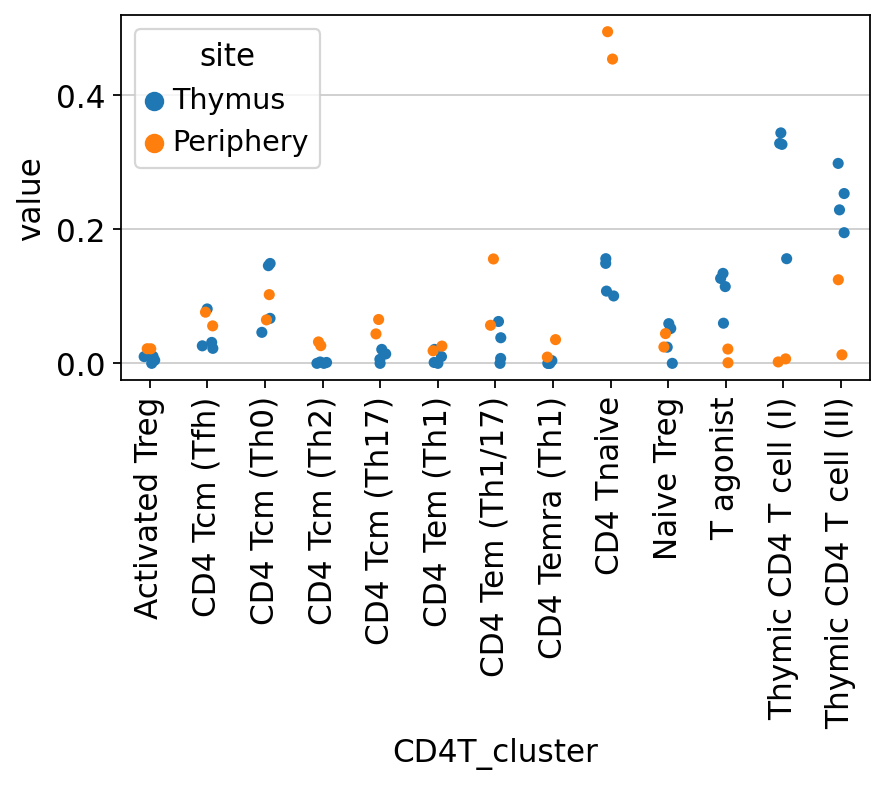

In [187]:
plt.figure(figsize=(6,3))
# sns.swarmplot(data=df_prop, x='CD4T_cluster', y='value', hue='site')
sns.stripplot(data=df_prop, x='CD4T_cluster', y='value', hue='site', order=list_label)
plt.xticks(rotation=90)
plt.savefig(str(sc.settings.figdir) + '/stripplot_site.pdf', bbox_inches='tight')

In [204]:
import pymc3 as pm
import arviz as az

print(f"Running on PyMC3 v{pm.__version__}")

donors = adata.obs.individual.unique()

x_t = []
x_b = []
n_t = []
n_b = []
for lab in list_label:
    _x_t = []
    _x_b = []
    _n_t = []
    _n_b = []
    for d in donors:
        try:
            _x_t.append(adata[(adata.obs['CD4T_cluster'] == lab) & (adata.obs['site'] == 'Thymus')
                            ].obs['individual'].value_counts()[d])
        except:
            _x_t.append(0)
            
        try:
            _x_b.append(adata[(adata.obs['CD4T_cluster'] == lab) & (adata.obs['site'] == 'Periphery')
                            ].obs['individual'].value_counts()[d])
        except:
            _x_b.append(0)
            
        try:
            _n_t.append(adata[adata.obs['site'] == 'Thymus'].obs['individual'].value_counts()[d])
        except:
            _n_t.append(0)
            
        try:
            _n_b.append(adata[adata.obs['site'] == 'Periphery'].obs['individual'].value_counts()[d])
        except:
            _n_b.append(0)
    x_t.append(_x_t)
    x_b.append(_x_b)
    n_t.append(_n_t)
    n_b.append(_n_b)

x_t = np.array(x_t).T
x_b = np.array(x_b).T
n_t = np.array(n_t).T
n_b = np.array(n_b).T

Running on PyMC3 v3.11.2


In [205]:
with pm.Model() as model:
    p_thymus = pm.Uniform("p_thymus", lower=0.0, upper=1.0, shape=len(list_label))
    p_blood = pm.Uniform("p_blood", lower=0.0, upper=1.0, shape=len(list_label))
    x_thymus = pm.Binomial("x_thymus", p=p_thymus, 
                           observed=x_t, 
                           n=n_t, shape=len(list_label))
    x_blood= pm.Binomial("x_blood", p=p_blood, observed=x_b, 
                         n=n_b, shape=len(list_label))
    
    p = pm.Deterministic("p", p_thymus - p_blood)

In [206]:
model

In [207]:
with model:
    trace = pm.sample(25000, chains=4)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [p_blood, p_thymus]


Sampling 4 chains for 1_000 tune and 25_000 draw iterations (4_000 + 100_000 draws total) took 29 seconds.


/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: The function `traceplot` from PyMC3 is just an alias for `plot_trace` from ArviZ. Please switch to `pymc3.plot_trace` or `arviz.plot_trace`.
  """Entry point for launching an IPython kernel.
/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


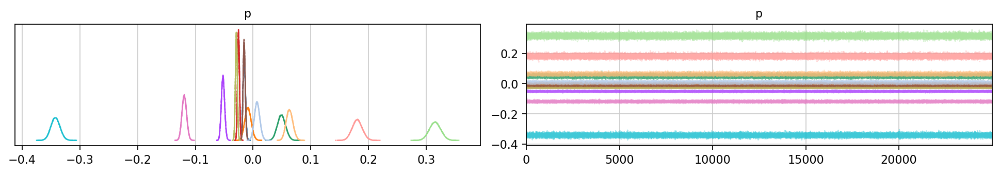

In [208]:
pm.traceplot(trace, var_names=["p"]);

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


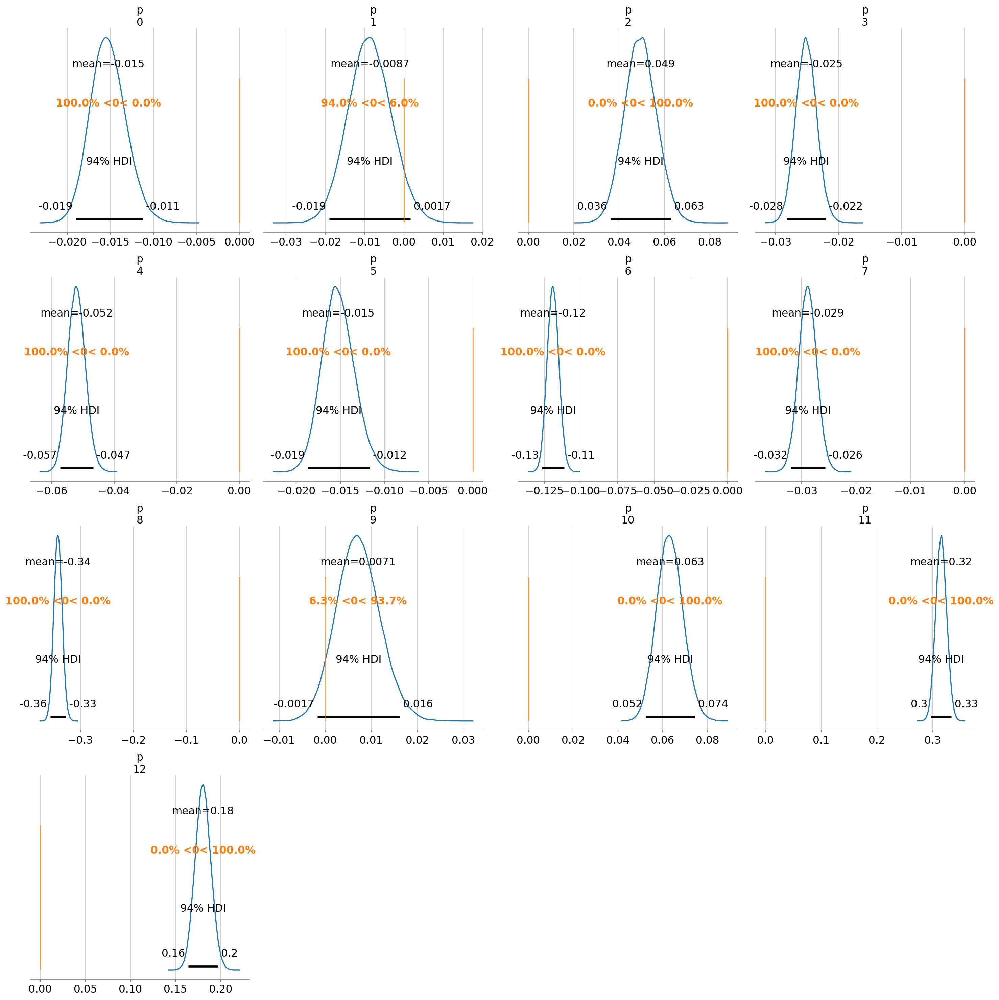

In [209]:
pm.plot_posterior(
    trace,
    var_names=["p"],
    ref_val = 0
);

In [210]:
pm.summary(trace)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
p_thymus[0],0.006,0.002,0.003,0.009,0.0,0.0,173750.0,69651.0,1.0
p_thymus[1],0.063,0.005,0.053,0.072,0.0,0.0,187619.0,72262.0,1.0
p_thymus[2],0.120,0.007,0.107,0.132,0.0,0.0,181596.0,71589.0,1.0
p_thymus[3],0.002,0.001,0.000,0.003,0.0,0.0,158993.0,70954.0,1.0
p_thymus[4],0.008,0.002,0.005,0.012,0.0,0.0,163679.0,70774.0,1.0
p_thymus[5],0.004,0.001,0.002,0.007,0.0,0.0,172365.0,71809.0,1.0
p_thymus[6],0.016,0.003,0.011,0.021,0.0,0.0,183655.0,71635.0,1.0
p_thymus[7],0.001,0.001,0.000,0.003,0.0,0.0,162036.0,71810.0,1.0
p_thymus[8],0.109,0.007,0.097,0.121,0.0,0.0,189309.0,76582.0,1.0
p_thymus[9],0.047,0.004,0.039,0.056,0.0,0.0,186318.0,73553.0,1.0


/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: The function `forestplot` from PyMC3 is just an alias for `plot_forest` from ArviZ. Please switch to `pymc3.plot_forest` or `arviz.plot_forest`.
  """Entry point for launching an IPython kernel.
/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


array([<AxesSubplot:title={'center':'94.0% HDI'}>], dtype=object)

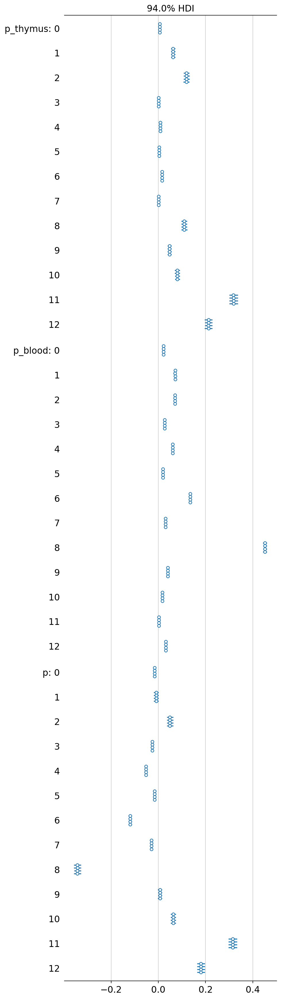

In [211]:
pm.forestplot(trace)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


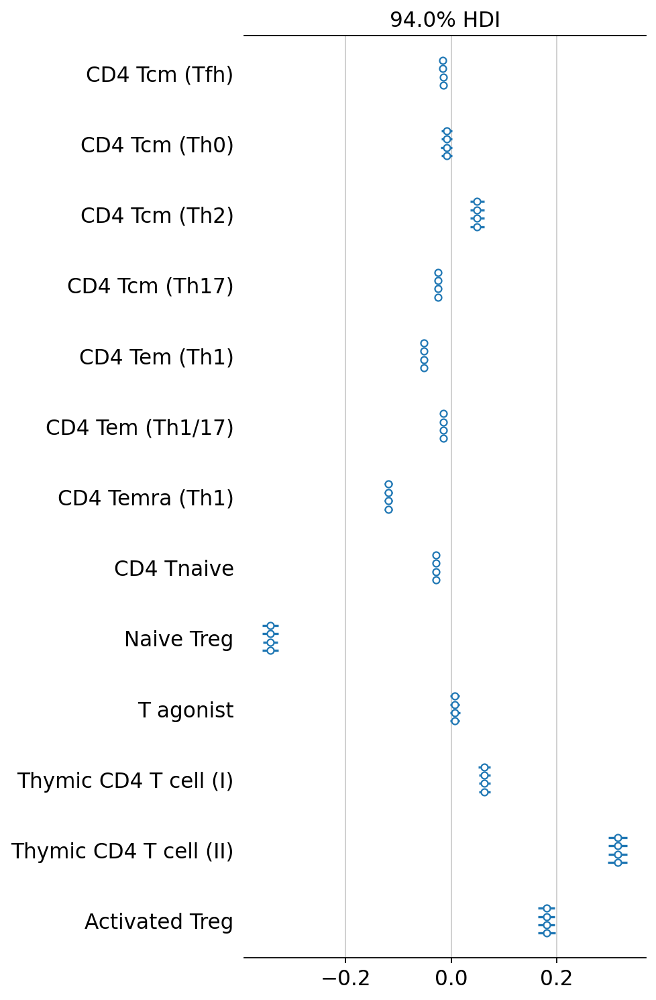

In [212]:
ax = az.plot_forest(trace, var_names=["p"])
ax[0].set_yticklabels([list_label[-i] for i in range(len(list_label))]);

In [213]:
p_thymus = []
p_blood = []

for i in range(len(list_label)):
    p_thymus.append((trace['p'][:,i] < 0).sum() / trace['p'].shape[0])
    p_blood.append((trace['p'][:,i] > 0).sum() / trace['p'].shape[0])
    
df_stats = pd.DataFrame([p_thymus, p_blood], index=['Thymus', 'Peripheral'], columns=list_label).T
df_stats

,Thymus,Peripheral
Activated Treg,1.00000,0.00000
CD4 Tcm (Tfh),0.93987,0.06013
CD4 Tcm (Th0),0.00000,1.00000
CD4 Tcm (Th2),1.00000,0.00000
CD4 Tcm (Th17),1.00000,0.00000
CD4 Tem (Th1),1.00000,0.00000
CD4 Tem (Th1/17),1.00000,0.00000
CD4 Temra (Th1),1.00000,0.00000
CD4 Tnaive,1.00000,0.00000
Naive Treg,0.06256,0.93744


In [214]:
df_summary = pm.summary(trace, hdi_prob=0.98)
df_summary

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


,mean,sd,hdi_1%,hdi_99%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
p_thymus[0],0.006,0.002,0.003,0.010,0.0,0.0,173750.0,69651.0,1.0
p_thymus[1],0.063,0.005,0.051,0.075,0.0,0.0,187619.0,72262.0,1.0
p_thymus[2],0.120,0.007,0.104,0.136,0.0,0.0,181596.0,71589.0,1.0
p_thymus[3],0.002,0.001,0.000,0.004,0.0,0.0,158993.0,70954.0,1.0
p_thymus[4],0.008,0.002,0.004,0.013,0.0,0.0,163679.0,70774.0,1.0
p_thymus[5],0.004,0.001,0.002,0.008,0.0,0.0,172365.0,71809.0,1.0
p_thymus[6],0.016,0.003,0.011,0.023,0.0,0.0,183655.0,71635.0,1.0
p_thymus[7],0.001,0.001,0.000,0.003,0.0,0.0,162036.0,71810.0,1.0
p_thymus[8],0.109,0.007,0.094,0.125,0.0,0.0,189309.0,76582.0,1.0
p_thymus[9],0.047,0.004,0.037,0.058,0.0,0.0,186318.0,73553.0,1.0


In [215]:
df_summary_thymus = df_summary.loc[[x for x in df_summary.index if 'p_thymus' in x]]
df_summary_thymus.index = list_label

df_summary_blood = df_summary.loc[[x for x in df_summary.index if 'p_blood' in x]]
df_summary_blood.index = list_label

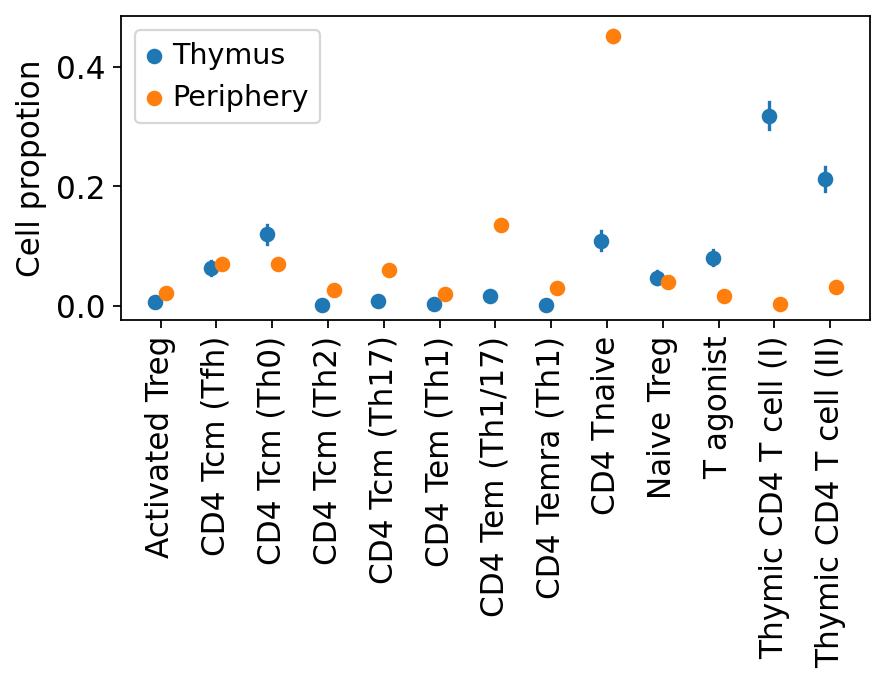

In [218]:
plt.figure(figsize=(6,2.5))
plt.scatter(np.array(range(len(list_label)))-0.1, df_summary_thymus['mean'], c='tab:blue', label='Thymus')
plt.scatter(np.array(range(len(list_label)))+0.1, df_summary_blood['mean'], c='tab:orange', label='Periphery')

for i,lab in enumerate(list_label):
    plt.plot([i-0.1, i-0.1],[df_summary_thymus.loc[lab,'hdi_1%'],df_summary_thymus.loc[lab,'hdi_99%']], c='tab:blue')
    plt.plot([i+0.1, i+0.1],[df_summary_blood.loc[lab,'hdi_1%'],df_summary_blood.loc[lab,'hdi_99%']], c='tab:orange')
    
plt.xticks(ticks=range(len(list_label)), labels=list_label, rotation=90)
plt.ylabel('Cell propotion')
plt.legend()
plt.grid(None)
plt.savefig(str(sc.settings.figdir) + '/forest_hdi1%99%.pdf', bbox_inches='tight')

In [37]:
# removed Thymic CD4T
list_label = ['Activated Treg', 'CD4 Tcm (Tfh)', 'CD4 Tcm (Th0)',
                  'CD4 Tcm (Th2)', 'CD4 Tcm (Th17)', 'CD4 Tem (Th1)',
                  'CD4 Tem (Th1/17)', 'CD4 Temra (Th1)', 'CD4 Tnaive',
                  'Naive Treg']

In [38]:
import scipy.stats as stats

list_prop = []

d = adata.obs[adata.obs['site'] == 'Thymus']
d['individual'] = d['individual'].str.split('_').str.get(0)
d = pd.crosstab(d['individual'], d['CD4T_cluster'])
d = d[list_label]
d = d.T / d.sum(axis=1)
d = d.reset_index().melt(id_vars='CD4T_cluster')
d['site'] = 'Thymus'

list_prop.append(d)

d = adata.obs[adata.obs['site'] == 'Periphery']
d['individual'] = d['individual'].str.split('_').str.get(0)
d = pd.crosstab(d['individual'], d['CD4T_cluster'])
d = d[list_label]
d = d.T / d.sum(axis=1)
d = d.reset_index().melt(id_vars='CD4T_cluster')
d['site'] = 'Periphery'
list_prop.append(d)

df_prop = pd.concat(list_prop)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


In [39]:
import statsmodels.stats.multitest as multi

list_p = []
for lab in list_label:
    _, p = stats.ttest_ind(df_prop.loc[(df_prop['site'] == 'Thymus') & (df_prop['CD4T_cluster'] == lab), 'value'],
                      df_prop.loc[(df_prop['site'] == 'Periphery') & (df_prop['CD4T_cluster'] == lab), 'value'])
    list_p.append(p)
multi.fdrcorrection(list_p)

(array([False, False, False,  True, False, False, False, False, False,
        False]),
 array([0.65890779, 0.58926652, 0.20297629, 0.01608356, 0.38564654,
        0.8114262 , 0.648347  , 0.3533493 , 0.58926652, 0.58926652]))

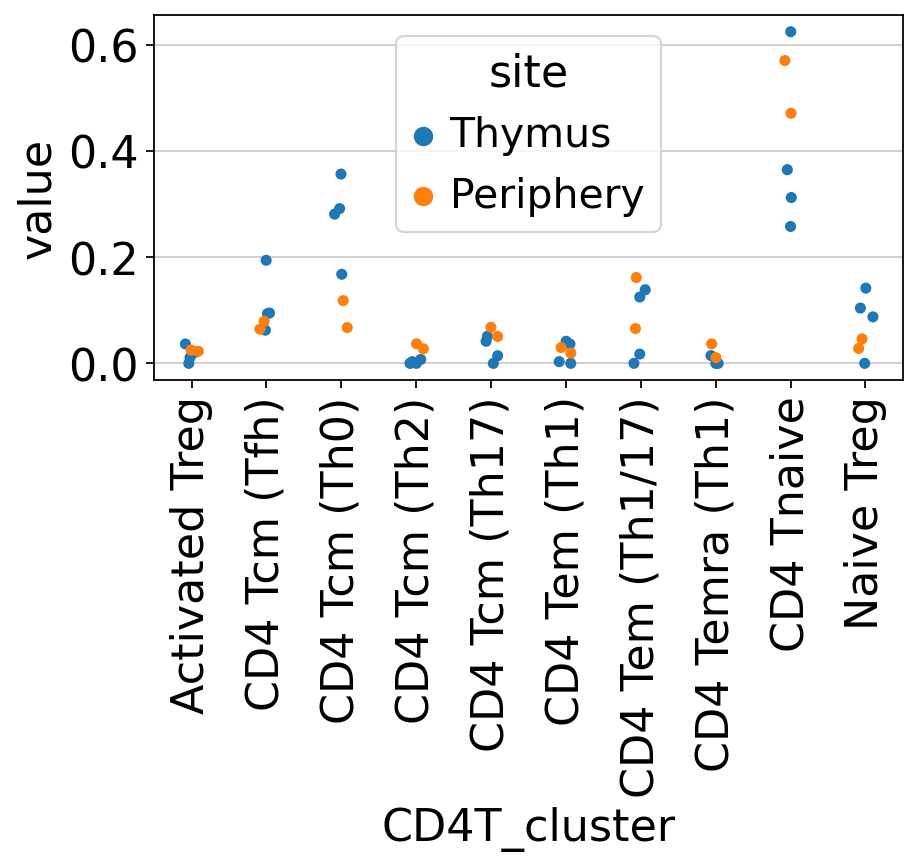

In [40]:
plt.figure(figsize=(6,3))
# sns.swarmplot(data=df_prop, x='CD4T_cluster', y='value', hue='site')
sns.stripplot(data=df_prop, x='CD4T_cluster', y='value', hue='site', order=list_label)
plt.xticks(rotation=90)
plt.savefig(str(sc.settings.figdir) + '/stripplot_site.ThymicTremoved.pdf', bbox_inches='tight')

In [41]:
import pymc3 as pm
import arviz as az

print(f"Running on PyMC3 v{pm.__version__}")

donors = adata.obs.individual.unique()

x_t = []
x_b = []
n_t = []
n_b = []
for lab in list_label:
    _x_t = []
    _x_b = []
    _n_t = []
    _n_b = []
    for d in donors:
        try:
            _x_t.append(adata[(adata.obs['CD4T_cluster'] == lab) & (adata.obs['site'] == 'Thymus')
                            ].obs['individual'].value_counts()[d])
        except:
            _x_t.append(0)
            
        try:
            _x_b.append(adata[(adata.obs['CD4T_cluster'] == lab) & (adata.obs['site'] == 'Periphery')
                            ].obs['individual'].value_counts()[d])
        except:
            _x_b.append(0)
            
        try:
            _n_t.append(adata[adata.obs['site'] == 'Thymus'].obs['individual'].value_counts()[d])
        except:
            _n_t.append(0)
            
        try:
            _n_b.append(adata[adata.obs['site'] == 'Periphery'].obs['individual'].value_counts()[d])
        except:
            _n_b.append(0)
    x_t.append(_x_t)
    x_b.append(_x_b)
    n_t.append(_n_t)
    n_b.append(_n_b)

x_t = np.array(x_t).T
x_b = np.array(x_b).T
n_t = np.array(n_t).T
n_b = np.array(n_b).T

Running on PyMC3 v3.11.2


In [42]:
with pm.Model() as model:
    p_thymus = pm.Uniform("p_thymus", lower=0.0, upper=1.0, shape=len(list_label))
    p_blood = pm.Uniform("p_blood", lower=0.0, upper=1.0, shape=len(list_label))
    x_thymus = pm.Binomial("x_thymus", p=p_thymus, 
                           observed=x_t, 
                           n=n_t, shape=len(list_label))
    x_blood= pm.Binomial("x_blood", p=p_blood, observed=x_b, 
                         n=n_b, shape=len(list_label))
    
    p = pm.Deterministic("p", p_thymus - p_blood)

In [43]:
with model:
    trace = pm.sample(25000, chains=4)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.
  
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [p_blood, p_thymus]


Sampling 4 chains for 1_000 tune and 25_000 draw iterations (4_000 + 100_000 draws total) took 32 seconds.


/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: The function `traceplot` from PyMC3 is just an alias for `plot_trace` from ArviZ. Please switch to `pymc3.plot_trace` or `arviz.plot_trace`.
  """Entry point for launching an IPython kernel.
/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


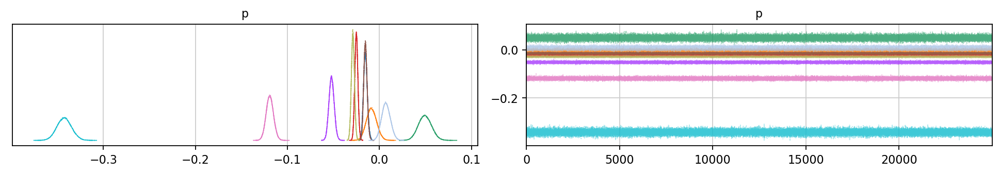

In [44]:
pm.traceplot(trace, var_names=["p"]);

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


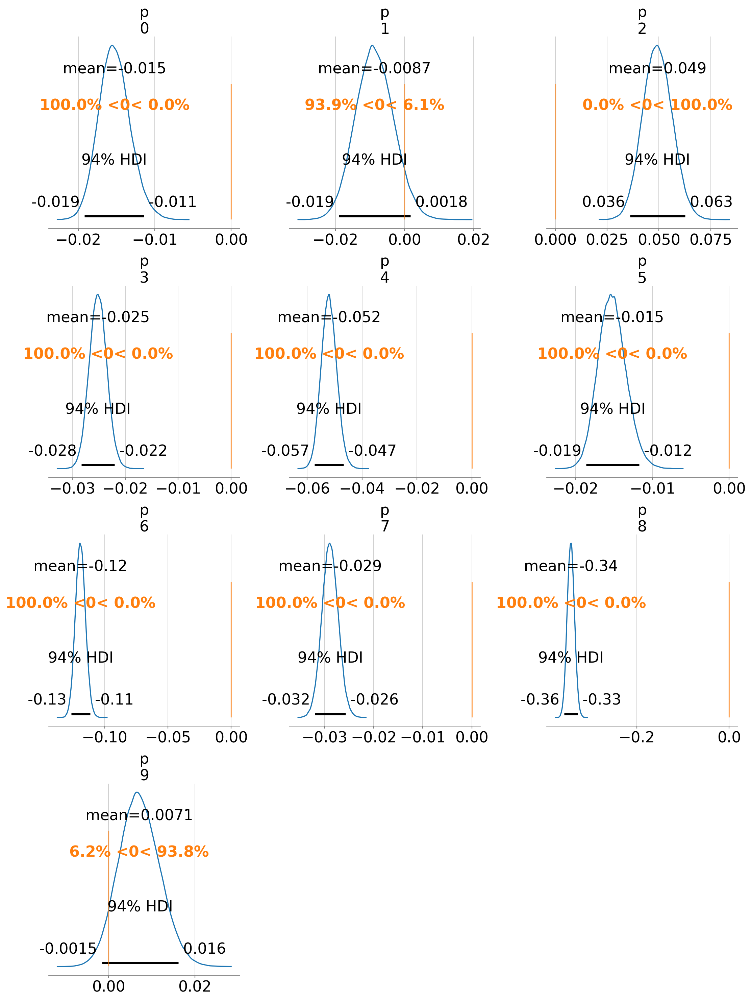

In [45]:
pm.plot_posterior(
    trace,
    var_names=["p"],
    ref_val = 0
);

In [46]:
pm.summary(trace)

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
p_thymus[0],0.006,0.002,0.003,0.009,0.0,0.0,164343.0,72380.0,1.0
p_thymus[1],0.063,0.005,0.053,0.072,0.0,0.0,169729.0,74049.0,1.0
p_thymus[2],0.119,0.007,0.107,0.132,0.0,0.0,177531.0,74655.0,1.0
p_thymus[3],0.002,0.001,0.000,0.003,0.0,0.0,152432.0,67512.0,1.0
p_thymus[4],0.008,0.002,0.005,0.012,0.0,0.0,167501.0,73044.0,1.0
p_thymus[5],0.004,0.001,0.002,0.007,0.0,0.0,168391.0,71223.0,1.0
p_thymus[6],0.016,0.003,0.012,0.021,0.0,0.0,180068.0,72386.0,1.0
p_thymus[7],0.001,0.001,0.000,0.003,0.0,0.0,146551.0,70388.0,1.0
p_thymus[8],0.109,0.007,0.097,0.122,0.0,0.0,178235.0,74207.0,1.0
p_thymus[9],0.047,0.004,0.039,0.056,0.0,0.0,174559.0,73932.0,1.0


In [47]:
p_thymus = []
p_blood = []

for i in range(len(list_label)):
    p_thymus.append((trace['p'][:,i] < 0).sum() / trace['p'].shape[0])
    p_blood.append((trace['p'][:,i] > 0).sum() / trace['p'].shape[0])
    
df_stats = pd.DataFrame([p_thymus, p_blood], index=['Thymus', 'Peripheral'], columns=list_label).T
df_stats

,Thymus,Peripheral
Activated Treg,1.00000,0.00000
CD4 Tcm (Tfh),0.93885,0.06115
CD4 Tcm (Th0),0.00000,1.00000
CD4 Tcm (Th2),1.00000,0.00000
CD4 Tcm (Th17),1.00000,0.00000
CD4 Tem (Th1),1.00000,0.00000
CD4 Tem (Th1/17),1.00000,0.00000
CD4 Temra (Th1),1.00000,0.00000
CD4 Tnaive,1.00000,0.00000
Naive Treg,0.06164,0.93836


In [48]:
df_summary = pm.summary(trace, hdi_prob=0.98)
df_summary

/home/yyasumizu/anaconda3/envs/scanpy1.7.2/lib/python3.7/site-packages/arviz/data/io_pymc3.py:100: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


,mean,sd,hdi_1%,hdi_99%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
p_thymus[0],0.006,0.002,0.003,0.010,0.0,0.0,164343.0,72380.0,1.0
p_thymus[1],0.063,0.005,0.051,0.075,0.0,0.0,169729.0,74049.0,1.0
p_thymus[2],0.119,0.007,0.104,0.136,0.0,0.0,177531.0,74655.0,1.0
p_thymus[3],0.002,0.001,0.000,0.004,0.0,0.0,152432.0,67512.0,1.0
p_thymus[4],0.008,0.002,0.004,0.013,0.0,0.0,167501.0,73044.0,1.0
p_thymus[5],0.004,0.001,0.002,0.008,0.0,0.0,168391.0,71223.0,1.0
p_thymus[6],0.016,0.003,0.011,0.023,0.0,0.0,180068.0,72386.0,1.0
p_thymus[7],0.001,0.001,0.000,0.003,0.0,0.0,146551.0,70388.0,1.0
p_thymus[8],0.109,0.007,0.095,0.125,0.0,0.0,178235.0,74207.0,1.0
p_thymus[9],0.047,0.004,0.037,0.058,0.0,0.0,174559.0,73932.0,1.0


In [49]:
df_summary_thymus = df_summary.loc[[x for x in df_summary.index if 'p_thymus' in x]]
df_summary_thymus.index = list_label

df_summary_blood = df_summary.loc[[x for x in df_summary.index if 'p_blood' in x]]
df_summary_blood.index = list_label

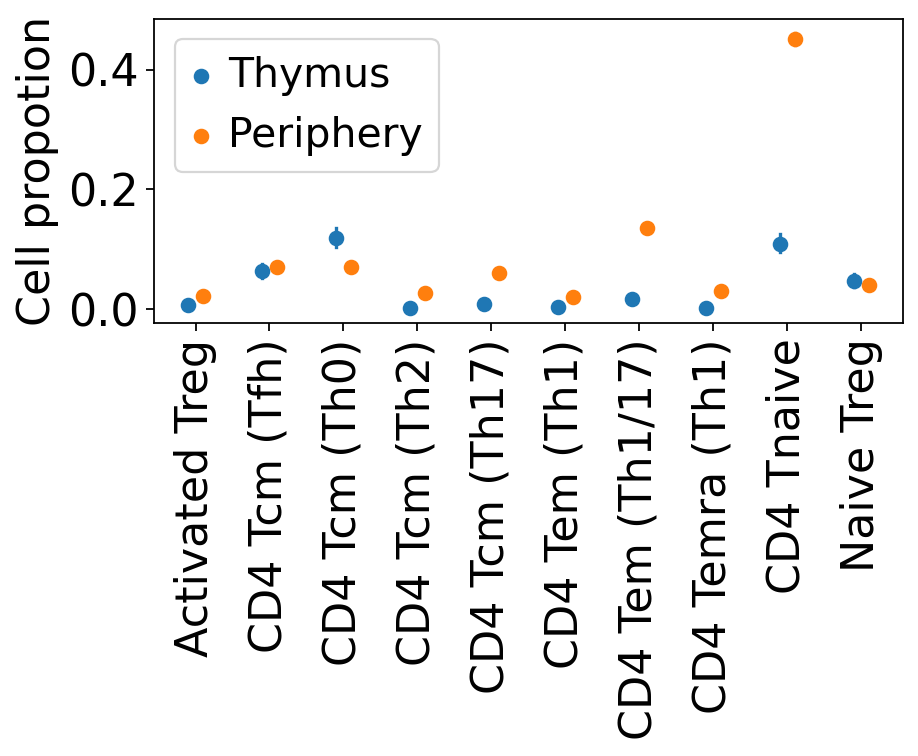

In [50]:
plt.figure(figsize=(6,2.5))
plt.scatter(np.array(range(len(list_label)))-0.1, df_summary_thymus['mean'], c='tab:blue', label='Thymus')
plt.scatter(np.array(range(len(list_label)))+0.1, df_summary_blood['mean'], c='tab:orange', label='Periphery')

for i,lab in enumerate(list_label):
    plt.plot([i-0.1, i-0.1],[df_summary_thymus.loc[lab,'hdi_1%'],df_summary_thymus.loc[lab,'hdi_99%']], c='tab:blue')
    plt.plot([i+0.1, i+0.1],[df_summary_blood.loc[lab,'hdi_1%'],df_summary_blood.loc[lab,'hdi_99%']], c='tab:orange')
    
plt.xticks(ticks=range(len(list_label)), labels=list_label, rotation=90)
plt.ylabel('Cell propotion')
plt.legend()
plt.grid(None)
plt.savefig(str(sc.settings.figdir) + '/forest_hdi1%99%.ThymicTremoved.pdf', bbox_inches='tight')

In [87]:
adata.write(results_file_CD4Tcell)

In [98]:
adata_raw = sc.read(results_raw_file_master)

adata_cg = adata_raw[adata.obs.index].copy()
adata_cg.obs = adata.obs
adata_cg.obsm = adata.obsm
adata_cg.uns = adata.uns

sc.pp.normalize_per_cell(adata_cg, counts_per_cell_after=1e4)
sc.pp.log1p(adata_cg)

adata_cg.write(results_file_cg_CD4Tcell)

normalizing by total count per cell
    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


## Thymus vs Peripheral

In [41]:
adata = sc.read(results_file_CD4Tcell)

In [42]:
# clu = 'Activated Treg'
clu = 'CD4 Tcm (Tfh)'
a = adata[adata.obs['CD4T_cluster'] == clu]

ranking genes
Trying to set attribute `.uns` of view, copying.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


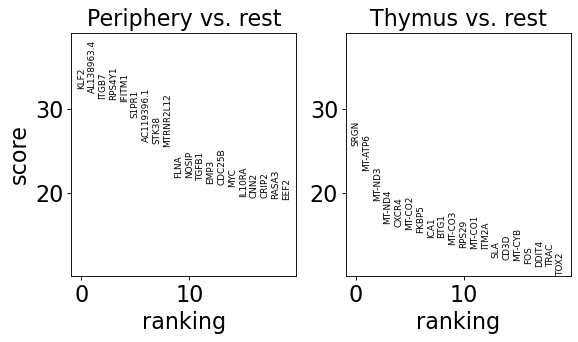

In [43]:
sc.tl.rank_genes_groups(a, 'site')
sc.pl.rank_genes_groups(a)

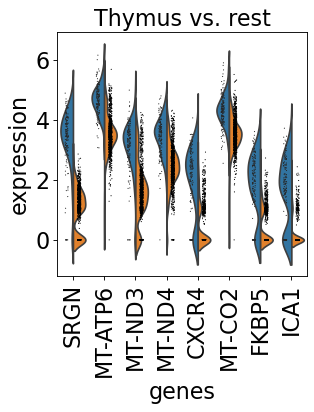

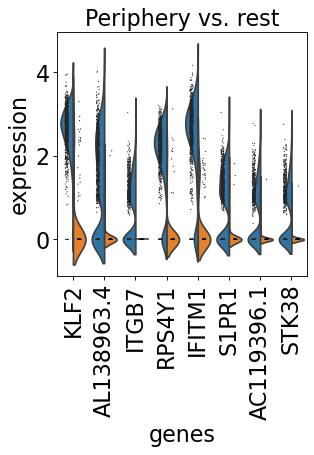

In [44]:
sc.pl.rank_genes_groups_violin(a, groups=['Thymus', 'Periphery'], n_genes=8)

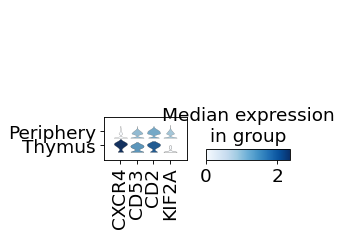

In [45]:
sc.pl.stacked_violin(a, ['CXCR4', 'CD53', 'CD2', 'KIF2A'], groupby='site')

ranking genes
Trying to set attribute `.uns` of view, copying.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


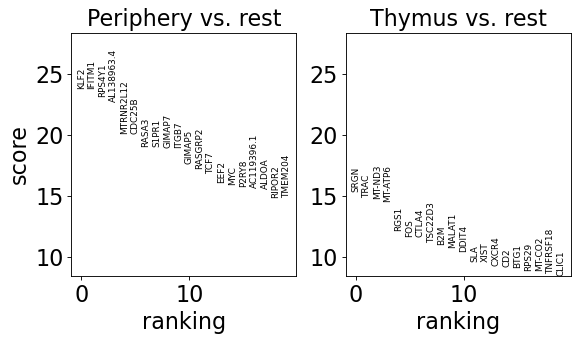

In [52]:
clu = 'Naive Treg'
a = adata[adata.obs['CD4T_cluster'] == clu]
sc.tl.rank_genes_groups(a, 'site')
sc.pl.rank_genes_groups(a)

In [62]:
list(adata.obs['CD4T_cluster'].unique())

['Naive Treg',
 'Thymic CD4 T cell (II)',
 'CD4 Tcm (Th17)',
 'CD4 Tnaive',
 'Thymic CD4 T cell (I)',
 'CD4 Tcm (Tfh)',
 'CD4 Tcm (Th0)',
 'T agonist',
 'CD8 Tnaive',
 'CD4 Tcm (Th2)',
 'CD4 Tem (Th1)',
 'CD4 Tem (Th1/17)',
 'Activated Treg',
 'CD4 Temra (Th1)']

In [63]:
list_clu = ['Naive Treg',
 'CD4 Tcm (Th17)',
 'CD4 Tnaive',
 'CD4 Tcm (Tfh)',
 'CD4 Tcm (Th0)',
 'CD4 Tcm (Th2)',
 'CD4 Tem (Th1)',
 'CD4 Tem (Th1/17)',
 'Activated Treg',
 'CD4 Temra (Th1)']

In [65]:
list_thymic_genes = []
for clu in list_clu:
    a = adata[adata.obs['CD4T_cluster'] == clu]
    sc.tl.rank_genes_groups(a, 'site')
#     sc.pl.rank_genes_groups(a)
    result = a.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    df_res = pd.DataFrame(
        {group + '_' + key[:1]: result[key][group]
        for group in groups for key in ['names', 'pvals_adj', 'logfoldchanges']})
    list_thymic_genes.append(list(df_res.loc[(df_res['Thymus_p'] < 0.05) & (df_res['Thymus_l'] > 1), 'Thymus_n']))

ranking genes
Trying to set attribute `.uns` of view, copying.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes
Trying to set attribute `.uns` of view, copying.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes
Trying to set attribute `.uns` of view, copying.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted 

In [67]:
import collections

In [70]:
c = collections.Counter([item for sublist in list_thymic_genes for item in sublist])

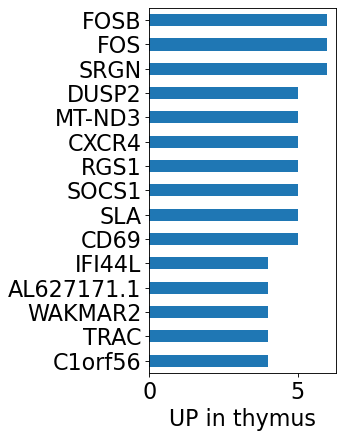

In [105]:
plt.figure(figsize=(3,6))
pd.Series(c).sort_values(ascending=False).head(15).sort_values().plot.barh()
plt.xlabel('UP in thymus')
plt.savefig(str(sc.settings.figdir) + '/barthymusperi.pdf', bbox_inches='tight')

In [93]:
adata.obs['cluster:site'] = adata.obs['CD4T_cluster'].astype(str) + ':' + adata.obs['site'].astype(str).str[0]

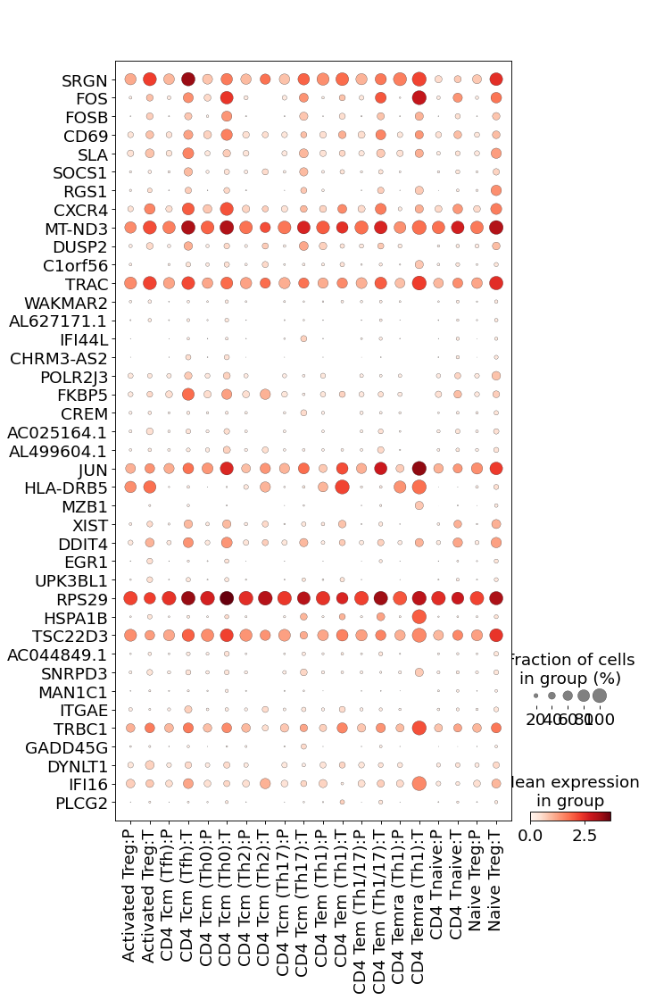

In [106]:
sc.pl.dotplot(adata[adata.obs['CD4T_cluster'].isin(list_clu)],
              pd.Series(c).sort_values(ascending=False).head(40).index, groupby='cluster:site',
             swap_axes=True, save='thymus_peri')

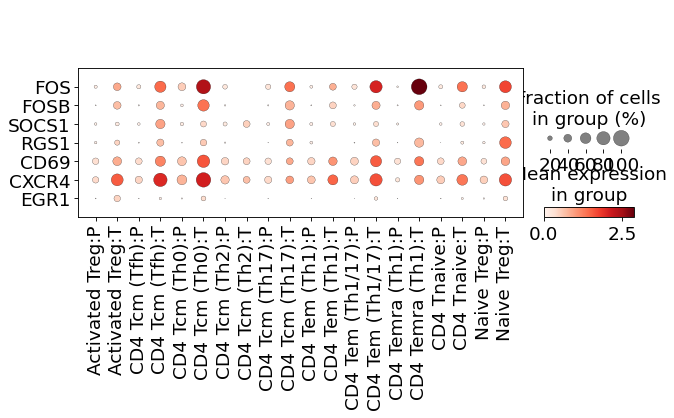

In [109]:
sc.pl.dotplot(adata[adata.obs['CD4T_cluster'].isin(list_clu)],
              ['FOS', 'FOSB', 'SOCS1', 'RGS1', 'CD69', 'CXCR4', 'EGR1'], groupby='cluster:site',
             swap_axes=True, save='thymus_peri_select')